# Chicago Traffic Crash Analysis – Task 1: Data Understanding & Preparation

**Goal:** Identify high-risk crash locations and their correlation with seasonal patterns, weather, traffic signal availability, speed limits, and crash severity.

---

## 📊 Task 1.1 – Data Understanding

We will explore the dataset to assess data quality, understand variable distributions, and detect correlations between key features.


In [24]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [25]:
# Import libraries
import math
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

from sklearn.preprocessing import StandardScaler
from scipy.stats import zscore

# Plotting settings
sns.set(style="whitegrid")
plt.rcParams["figure.figsize"] = (10, 6)


###  Load Datasets

We'll start by loading the main `crashes.csv` dataset. This is the core dataset for our analysis and contains information on all reported incidents. We are adding `people.csv` and `vehicle.csv` and aggregating and doing the feature engineering here.


In [26]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

# Load raw datasets
crashes = pd.read_csv('/content/drive/MyDrive/Traffic_Crashes_-_Crashes_20250407.csv')
people = pd.read_csv('/content/drive/MyDrive/Traffic_Crashes_-_People_20250407.csv')
vehicles = pd.read_csv('/content/drive/MyDrive/Traffic_Crashes_-_Vehicles_20250407.csv')


Mounted at /content/drive


<ipython-input-26-716be9323e27>:6: DtypeWarning: Columns (19,28) have mixed types. Specify dtype option on import or set low_memory=False.
  people = pd.read_csv('/content/drive/MyDrive/Traffic_Crashes_-_People_20250407.csv')
<ipython-input-26-716be9323e27>:7: DtypeWarning: Columns (20,39,40,41,43,47,48,49,52,54,57,58,60,70) have mixed types. Specify dtype option on import or set low_memory=False.
  vehicles = pd.read_csv('/content/drive/MyDrive/Traffic_Crashes_-_Vehicles_20250407.csv')


###  Dataset Overview

Let’s take an initial look at the data structure: columns, data types, and completeness.

In [ ]:
# Basic info
crashes_df.info()

# Show first few rows
crashes_df.head()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 932691 entries, 0 to 932690
Data columns (total 48 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   CRASH_RECORD_ID                932691 non-null  object 
 1   CRASH_DATE_EST_I               68519 non-null   object 
 2   CRASH_DATE                     932691 non-null  object 
 3   POSTED_SPEED_LIMIT             932691 non-null  int64  
 4   TRAFFIC_CONTROL_DEVICE         932691 non-null  object 
 5   DEVICE_CONDITION               932691 non-null  object 
 6   WEATHER_CONDITION              932691 non-null  object 
 7   LIGHTING_CONDITION             932691 non-null  object 
 8   FIRST_CRASH_TYPE               932691 non-null  object 
 9   TRAFFICWAY_TYPE                932691 non-null  object 
 10  LANE_CNT                       199023 non-null  float64
 11  ALIGNMENT                      932691 non-null  object 
 12  ROADWAY_SURFACE_COND          

,CRASH_RECORD_ID,CRASH_DATE_EST_I,CRASH_DATE,POSTED_SPEED_LIMIT,TRAFFIC_CONTROL_DEVICE,DEVICE_CONDITION,WEATHER_CONDITION,LIGHTING_CONDITION,FIRST_CRASH_TYPE,TRAFFICWAY_TYPE,...,INJURIES_NON_INCAPACITATING,INJURIES_REPORTED_NOT_EVIDENT,INJURIES_NO_INDICATION,INJURIES_UNKNOWN,CRASH_HOUR,CRASH_DAY_OF_WEEK,CRASH_MONTH,LATITUDE,LONGITUDE,LOCATION
0,019d84ab0f03ace0b07075b0a7d83ba867b7dadad30410...,Y,03/29/2025 06:10:00 PM,35,STOP SIGN/FLASHER,NO CONTROLS,RAIN,DAYLIGHT,ANGLE,NOT DIVIDED,...,0.0,1.0,4.0,0.0,18,7,3,41.793739,-87.697311,POINT (-87.697311324011 41.793738897511)
1,00a530520c84927490b597a6220ff3f2a3347472ef3086...,NaN,01/15/2025 01:50:00 PM,30,NO CONTROLS,NO CONTROLS,CLEAR,DAYLIGHT,FIXED OBJECT,RAMP,...,0.0,0.0,1.0,0.0,13,4,1,41.816073,-87.656743,POINT (-87.656742699936 41.816073475493)
2,03a3b86d3b62c8948e25623db7ccf326fed99eaa297b59...,NaN,03/15/2025 12:01:00 AM,30,NO CONTROLS,NO CONTROLS,RAIN,"DARKNESS, LIGHTED ROAD",PARKED MOTOR VEHICLE,DIVIDED - W/MEDIAN (NOT RAISED),...,0.0,0.0,1.0,0.0,0,7,3,41.836784,-87.723610,POINT (-87.723610276569 41.836784034697)
3,05a9c5c6ab19f092cd1477140875cf33cc6f157c761168...,NaN,03/28/2025 09:59:00 AM,30,TRAFFIC SIGNAL,FUNCTIONING PROPERLY,CLEAR,DAYLIGHT,TURNING,NOT DIVIDED,...,0.0,0.0,5.0,0.0,9,6,3,41.813278,-87.723642,POINT (-87.723641881733 41.813277928858)
4,088061d9b7e5ab5b1353517ebefcadca065c20de8ca860...,N,03/15/2025 02:12:00 PM,30,TRAFFIC SIGNAL,FUNCTIONING PROPERLY,UNKNOWN,UNKNOWN,PEDALCYCLIST,FOUR WAY,...,0.0,0.0,2.0,0.0,14,7,3,41.871778,-87.625789,POINT (-87.625789124419 41.871778332743)


###  Data Quality Check

We assess missing values, duplicated records, and summary statistics to understand the dataset's quality.


In [ ]:
# Summary stats for numerical columns
crashes_df.describe()

# Missing values
missing_counts = crashes_df.isnull().sum()
missing_percent = (missing_counts / len(crashes_df)) * 100
missing_df = pd.DataFrame({'Missing Count': missing_counts, 'Missing %': missing_percent})
missing_df[missing_df["Missing Count"] > 0].sort_values(by="Missing %", ascending=False)

# Duplicated records
print(f"Duplicated rows: {crashes_df.duplicated().sum()}")


Duplicated rows: 0


### Data Semantics

Here is the interpretation of selected key features in the `crashes_df` dataset:

- **CRASH_DATE**: Timestamp of when the crash occurred.
- **POSTED_SPEED_LIMIT**: Legal speed limit at the location (in mph).
- **TRAFFIC_CONTROL_DEVICE**: Type of traffic control (signal, sign, etc.).
- **WEATHER_CONDITION**: Reported weather during the crash.
- **LIGHTING_CONDITION**: Whether it was day, night, or dusk.
- **INJURIES_TOTAL**: Total number of injuries resulting from the crash.
- **INJURIES_FATAL**: Number of fatalities.
- **DAMAGE**: Reported damage level.
- **LATITUDE / LONGITUDE**: Geographic coordinates of the crash.
- **BEAT_OF_OCCURRENCE**: Police beat (a sub-area of a district) where the crash happened.
- **CRASH_TYPE**: Nature of the crash (rear-end, turning, head-on, etc.)
- **PRIM_CONTRIBUTORY_CAUSE**: Main cause reported by the officer.

We'll now explore the distributions of key variables to understand how they behave.


### 📊 Variable Distribution Analysis

We will analyze the distributions of key numeric and categorical variables to understand crash patterns.


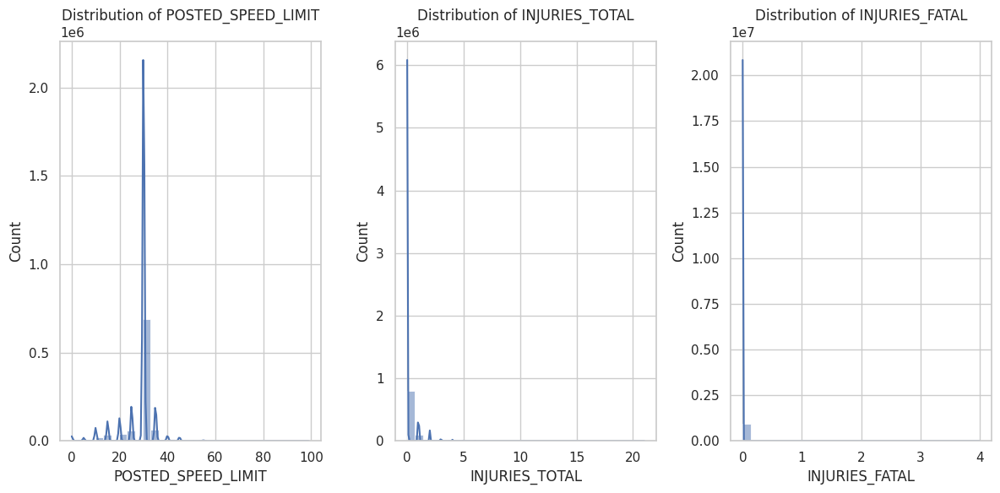

In [ ]:
# Numeric columns to explore
num_cols = ["POSTED_SPEED_LIMIT", "INJURIES_TOTAL", "INJURIES_FATAL"]

# Create a 2x2 grid of subplots
fig, axes = plt.subplots(1, 3, figsize=(12, 6)) # Adjust figsize as needed

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Loop through columns and plot on subplots
for i, col in enumerate(num_cols):
    sns.histplot(data=crashes_df, x=col, kde=True, bins=30, ax=axes[i])
    axes[i].set_title(f'Distribution of {col}')

# Adjust layout and display
plt.tight_layout()
plt.show()

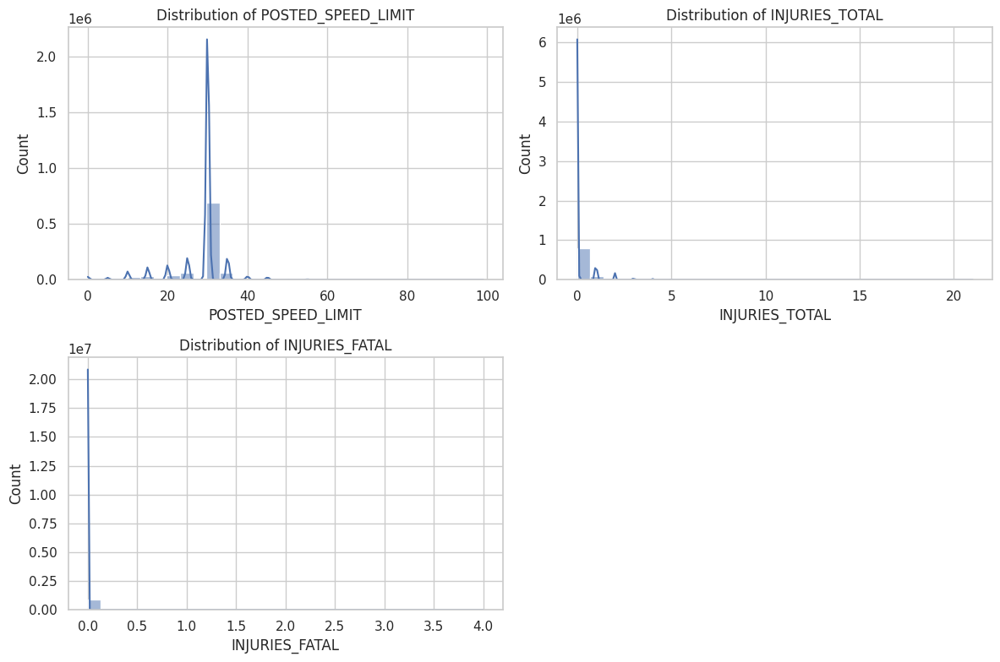

In [ ]:
# Numeric columns to explore
num_cols = ["POSTED_SPEED_LIMIT", "INJURIES_TOTAL", "INJURIES_FATAL"]

# Create a 2x2 grid of subplots
fig, axes = plt.subplots(2, 2, figsize=(12, 8))  # Adjust figsize as needed

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Loop through columns and plot on subplots
for i, col in enumerate(num_cols):
    sns.histplot(data=crashes_df, x=col, kde=True, bins=30, ax=axes[i])
    axes[i].set_title(f'Distribution of {col}')

# Remove the extra empty subplot (if any)
if len(num_cols) < 4:
    fig.delaxes(axes[-1])

# Adjust layout and display
plt.tight_layout()
plt.show()

In [ ]:
# Convert to datetime
crashes_df['CRASH_DATE'] = pd.to_datetime(crashes_df['CRASH_DATE'])

# Extract useful features
crashes_df['CRASH_HOUR'] = crashes_df['CRASH_DATE'].dt.hour
crashes_df['CRASH_DAY_OF_WEEK'] = crashes_df['CRASH_DATE'].dt.dayofweek  # 0=Monday
crashes_df['CRASH_MONTH'] = crashes_df['CRASH_DATE'].dt.month


<ipython-input-73-ab83fad11df6>:2: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  crashes_df['CRASH_DATE'] = pd.to_datetime(crashes_df['CRASH_DATE'])


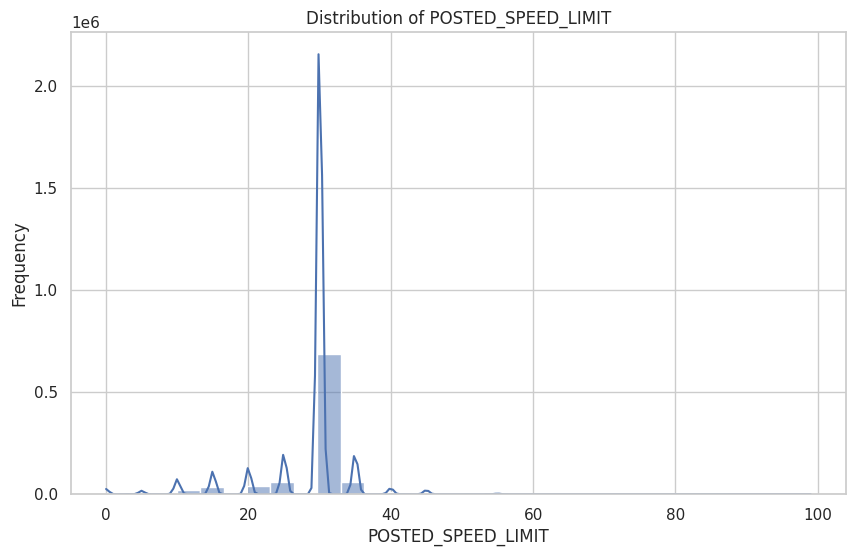

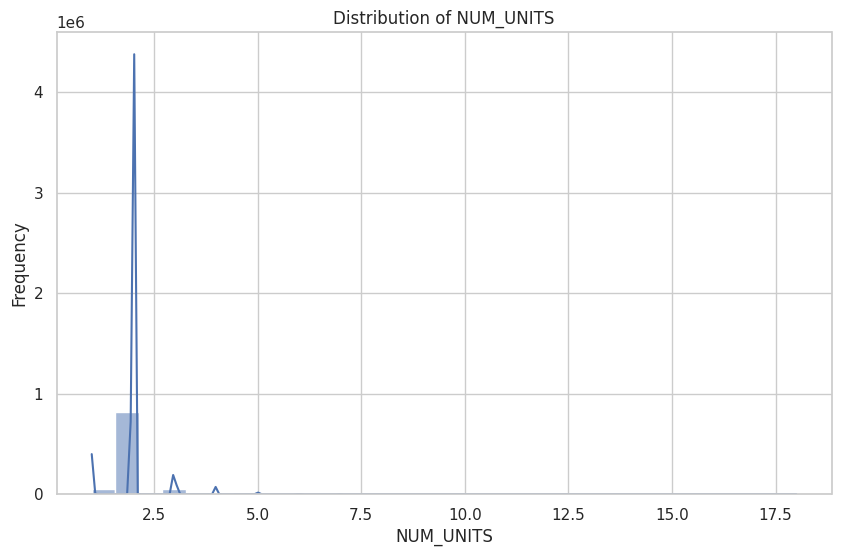

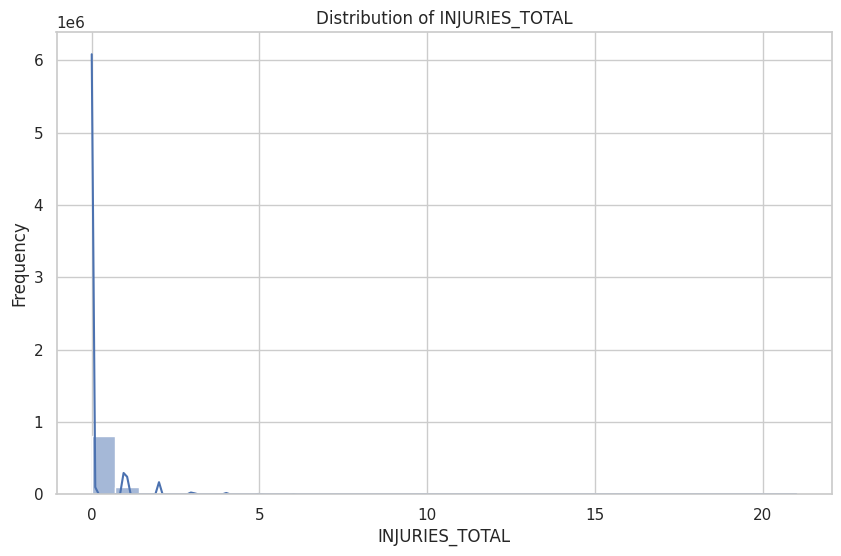

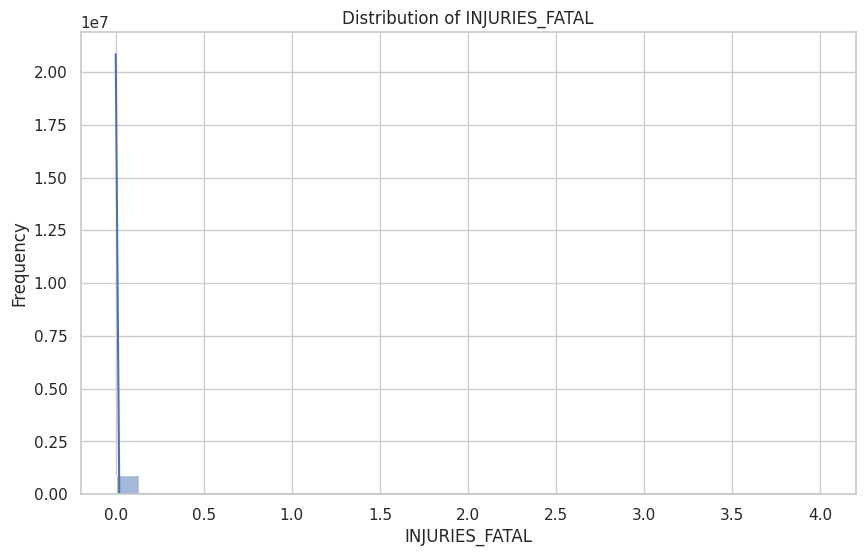

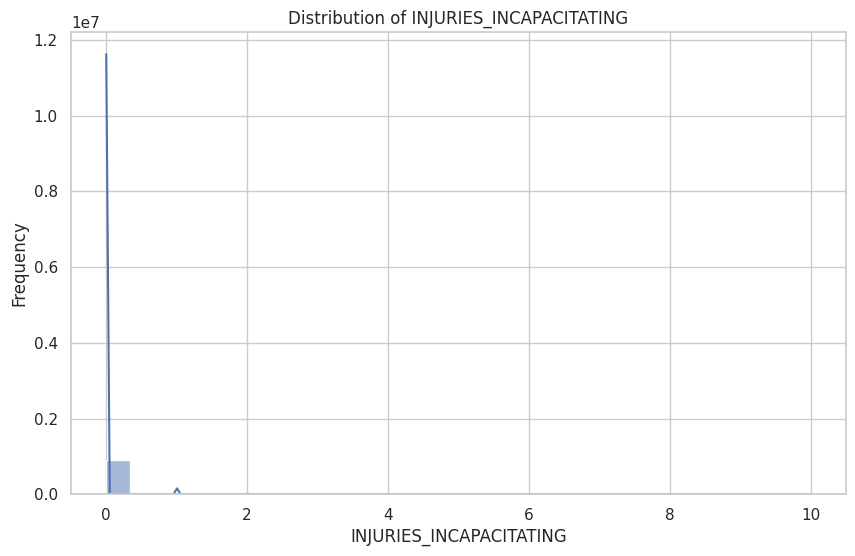

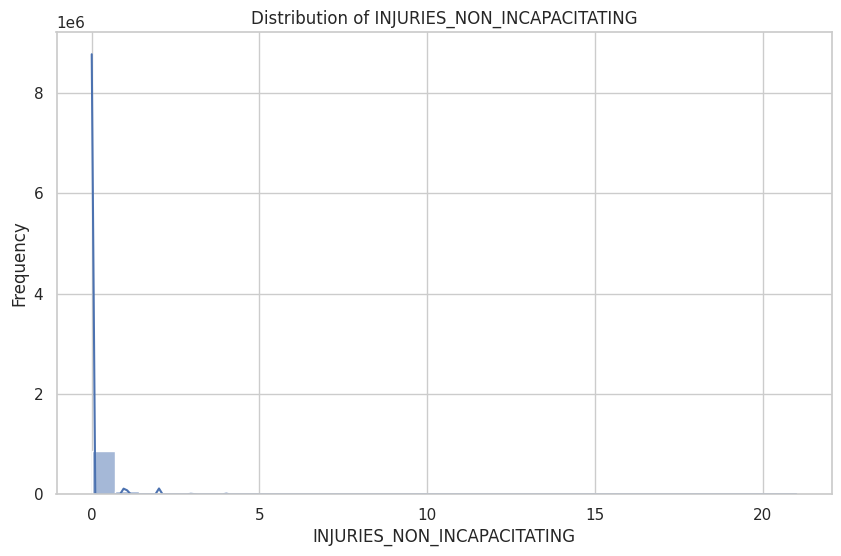

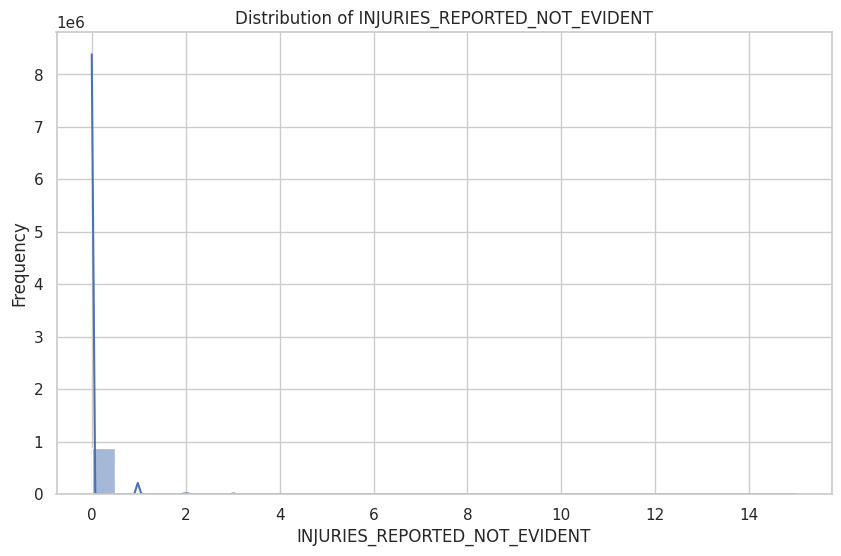

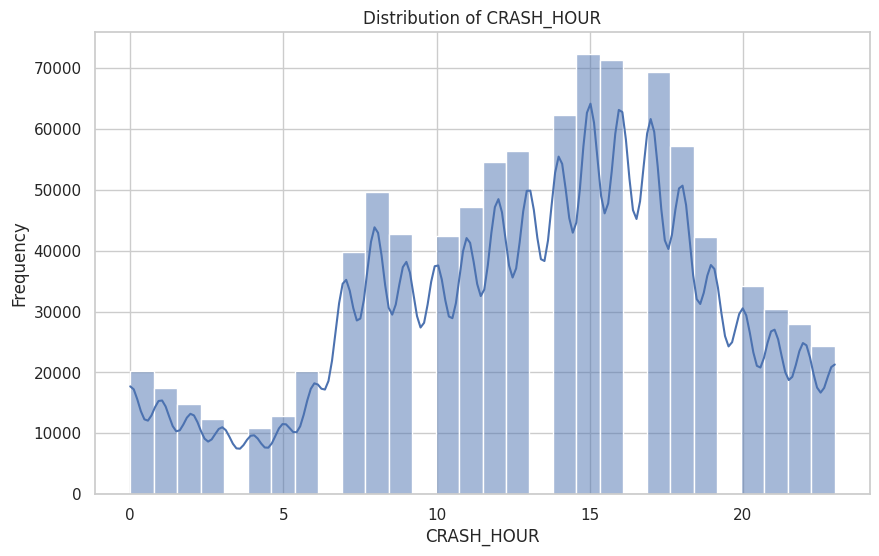

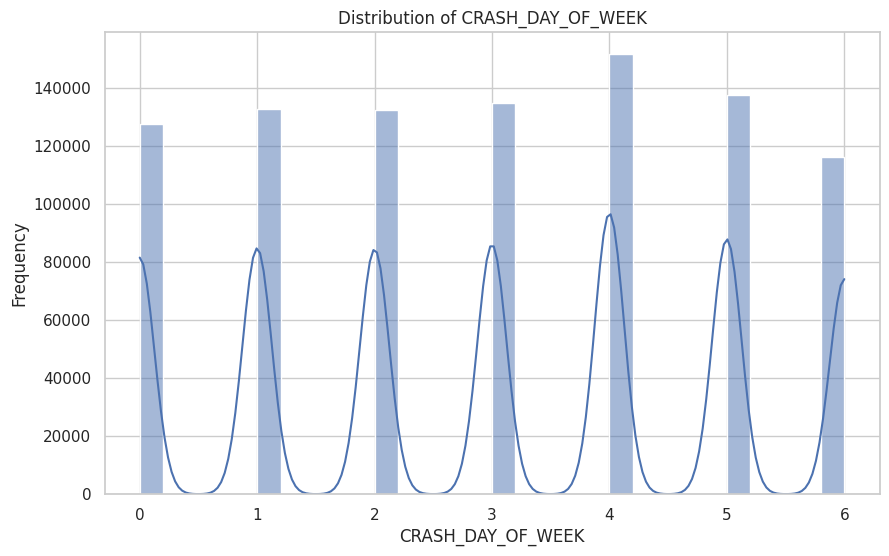

In [ ]:
# Extended list of numeric columns
num_cols = [
    "POSTED_SPEED_LIMIT", "NUM_UNITS", "INJURIES_TOTAL", "INJURIES_FATAL",
    "INJURIES_INCAPACITATING", "INJURIES_NON_INCAPACITATING",
    "INJURIES_REPORTED_NOT_EVIDENT", "CRASH_HOUR", "CRASH_DAY_OF_WEEK"
]

# Plot histograms with KDE
for col in num_cols:
    sns.histplot(crashes_df[col].dropna(), kde=True, bins=30)
    plt.title(f'Distribution of {col}')
    plt.xlabel(col)
    plt.ylabel("Frequency")
    plt.show()


## Missing values

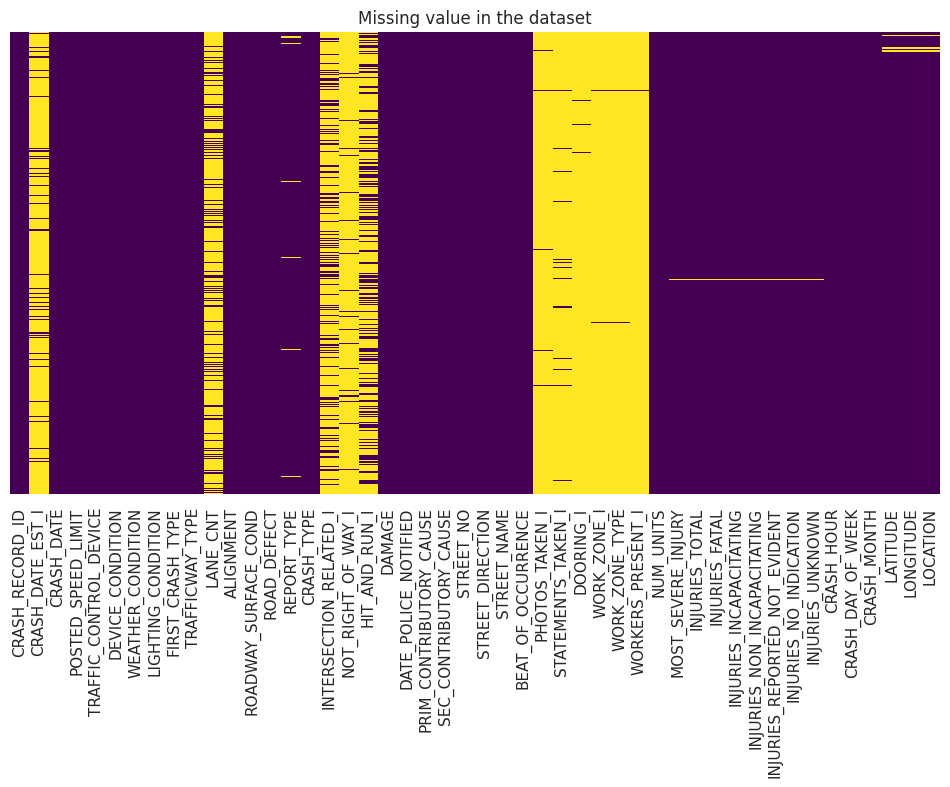

In [ ]:
## Plot missing values
plt.figure(figsize=(12,6))
sns.heatmap(crashes_df.isnull(), cbar=False, cmap='viridis', yticklabels=False)
plt.title('Missing value in the dataset')
plt.show()

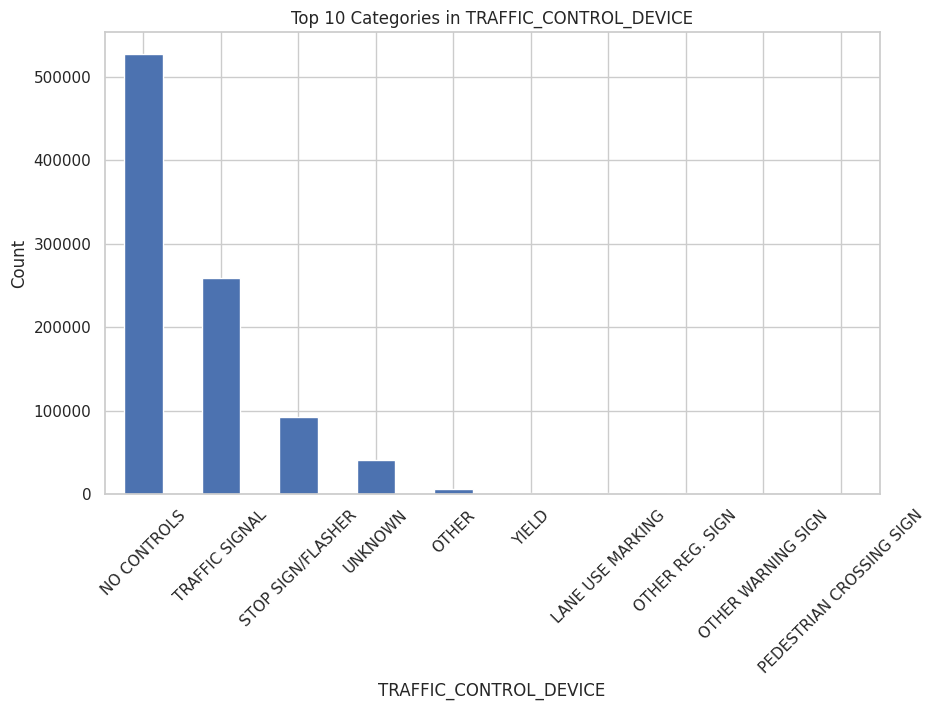

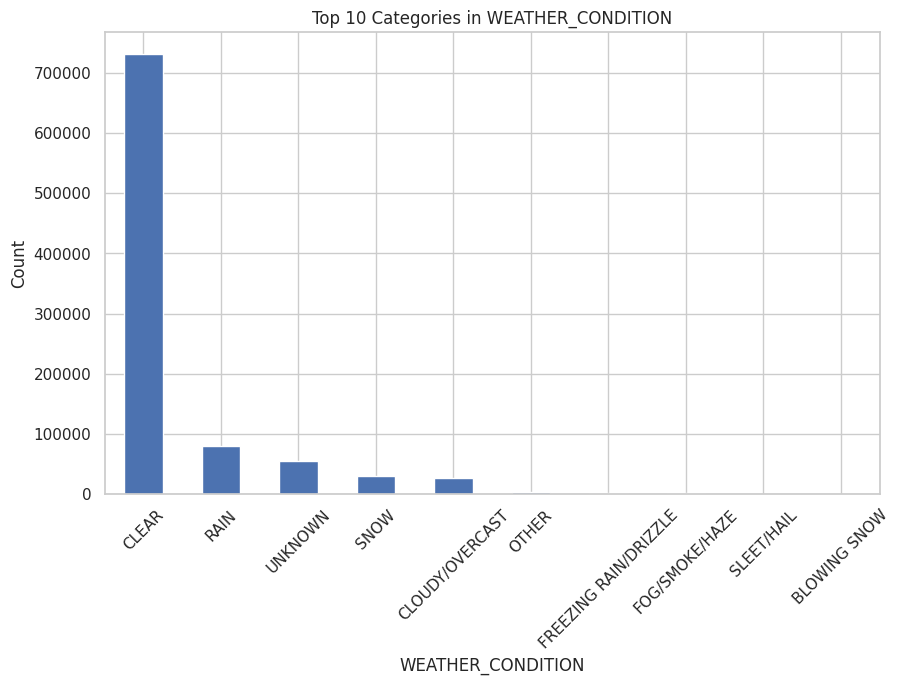

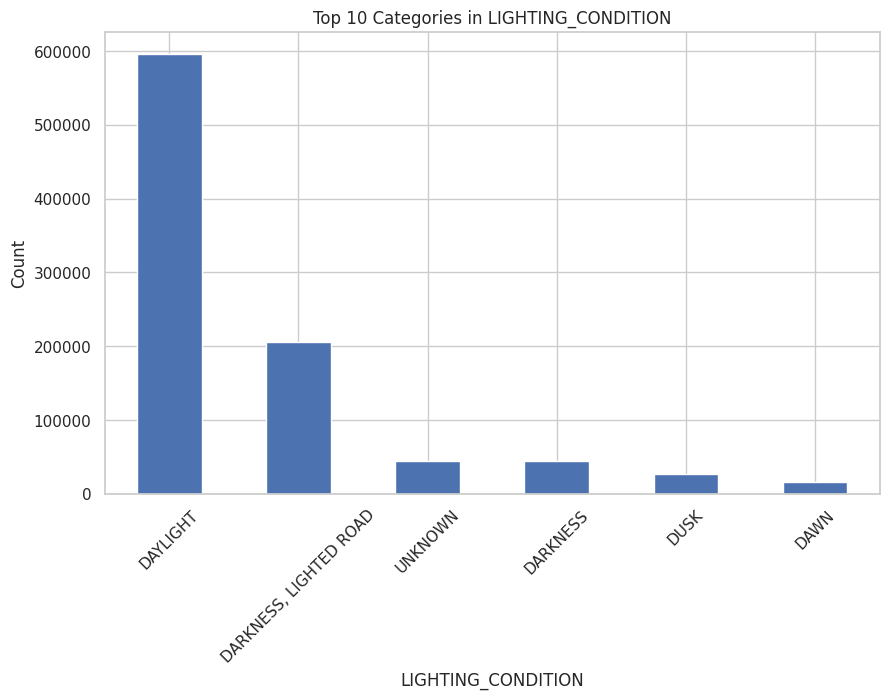

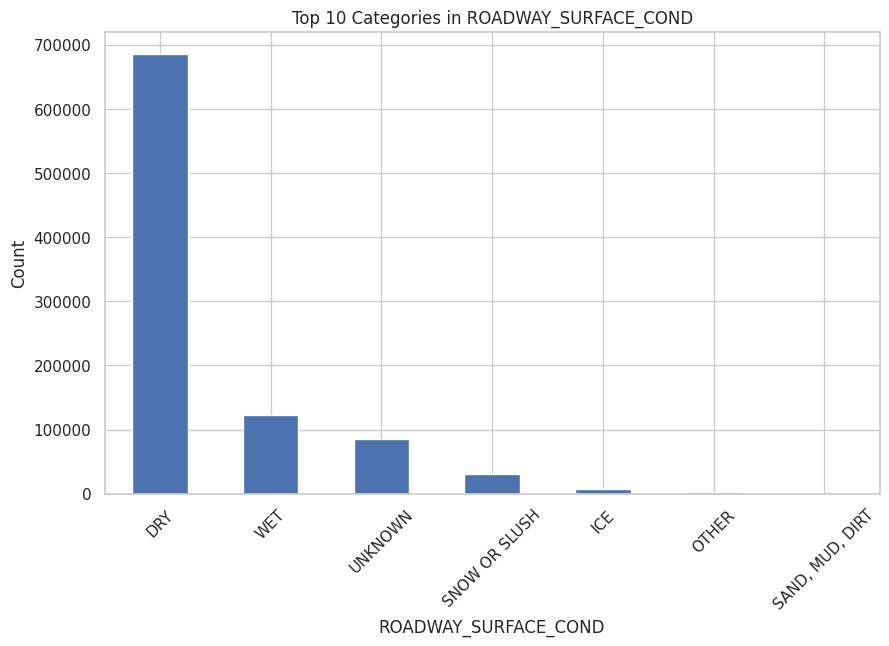

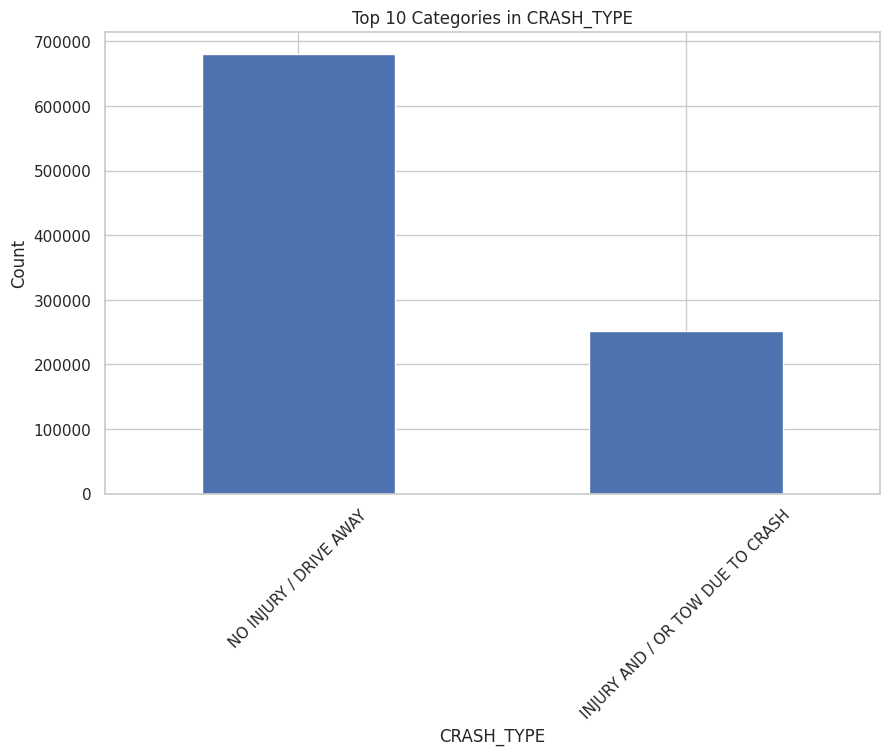

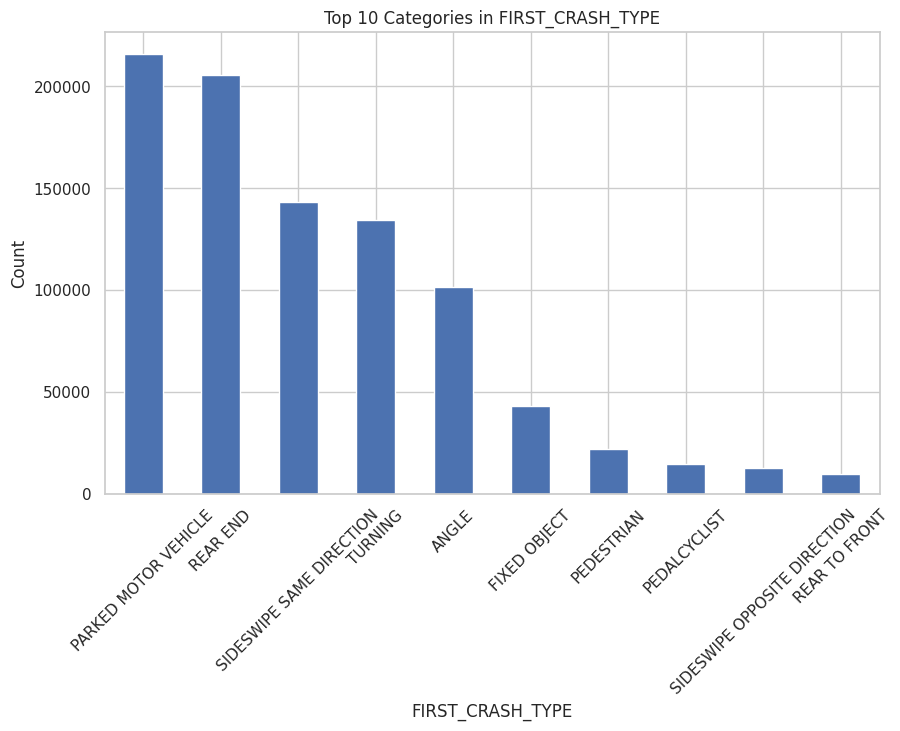

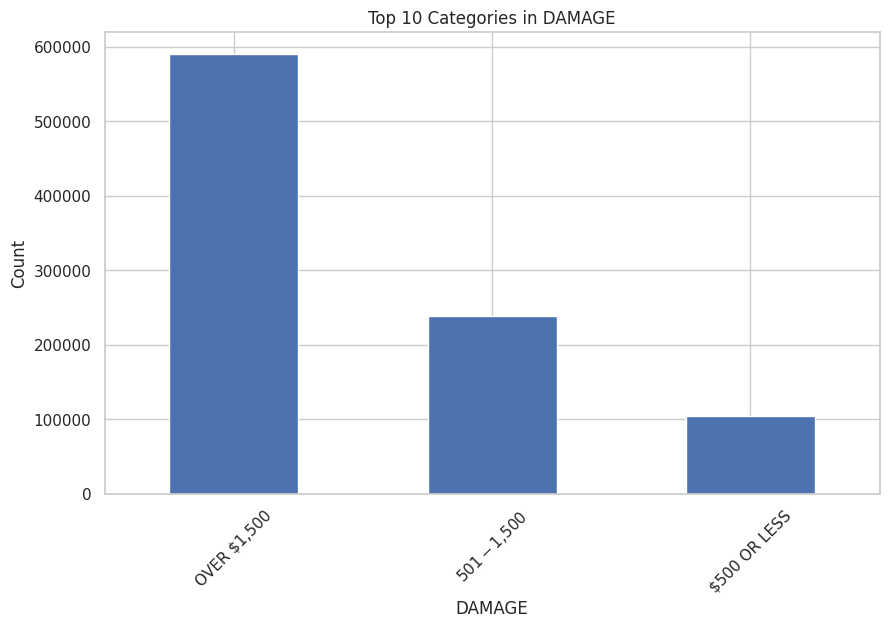

In [ ]:
cat_cols = ["TRAFFIC_CONTROL_DEVICE", "WEATHER_CONDITION", "LIGHTING_CONDITION",
            "ROADWAY_SURFACE_COND", "CRASH_TYPE", "FIRST_CRASH_TYPE", "DAMAGE"]

for col in cat_cols:
    crashes_df[col].value_counts().head(10).plot(kind='bar')
    plt.title(f'Top 10 Categories in {col}')
    plt.xlabel(col)
    plt.ylabel('Count')
    plt.xticks(rotation=45)
    plt.show()


### Correlation Matrix

This heatmap shows the pairwise correlations between numerical features.


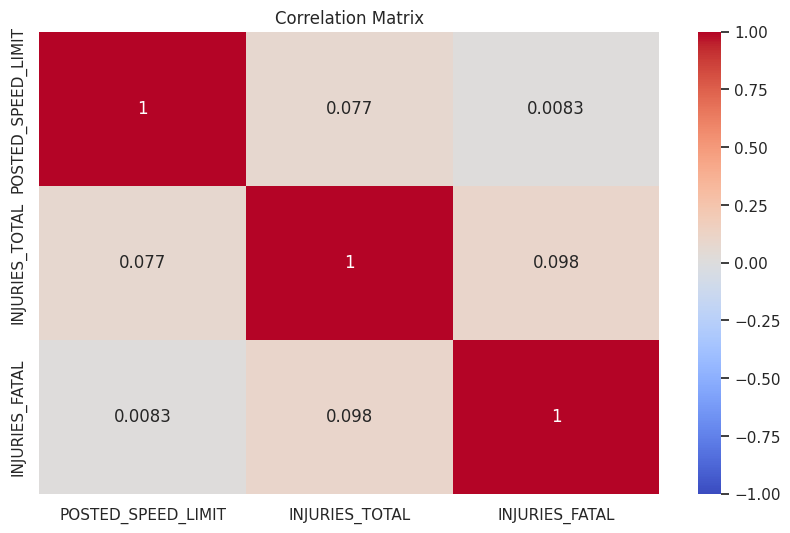

In [ ]:
# Compute correlation matrix
num_data = crashes_df[["POSTED_SPEED_LIMIT", "INJURIES_TOTAL", "INJURIES_FATAL"]].copy()
corr = num_data.corr()

# Plot heatmap
sns.heatmap(corr, annot=True, cmap="coolwarm", vmin=-1, vmax=1)
plt.title("Correlation Matrix")
plt.show()


###  Extended Correlation Matrix

We analyze pairwise relationships between injury types, speed limit, time of crash, and number of units to identify potential high-impact factors.


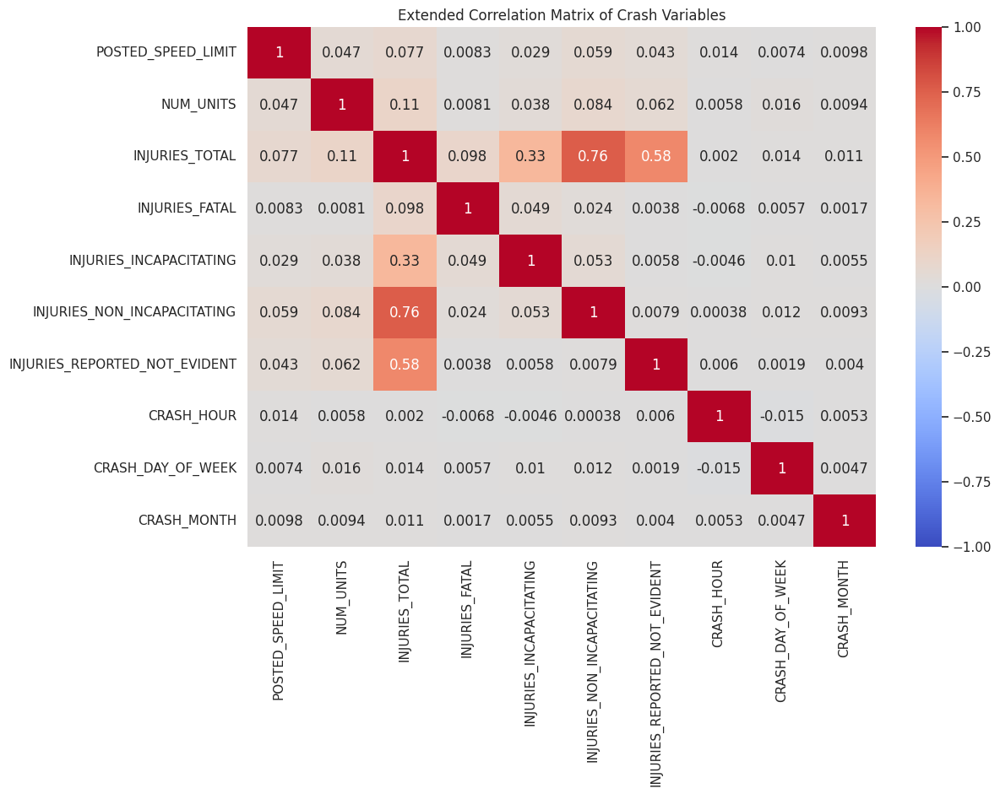

In [ ]:
# Select relevant numeric features for correlation
corr_cols = [
    "POSTED_SPEED_LIMIT", "NUM_UNITS", "INJURIES_TOTAL", "INJURIES_FATAL",
    "INJURIES_INCAPACITATING", "INJURIES_NON_INCAPACITATING",
    "INJURIES_REPORTED_NOT_EVIDENT", "CRASH_HOUR", "CRASH_DAY_OF_WEEK", "CRASH_MONTH"
]

# Compute correlations
corr_matrix = crashes_df[corr_cols].corr()

# Plot heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Extended Correlation Matrix of Crash Variables')
plt.show()


In [ ]:
# Function to map month to season
def get_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    else:
        return 'Fall'

# Apply function
crashes_df['SEASON'] = crashes_df['CRASH_MONTH'].apply(get_season)


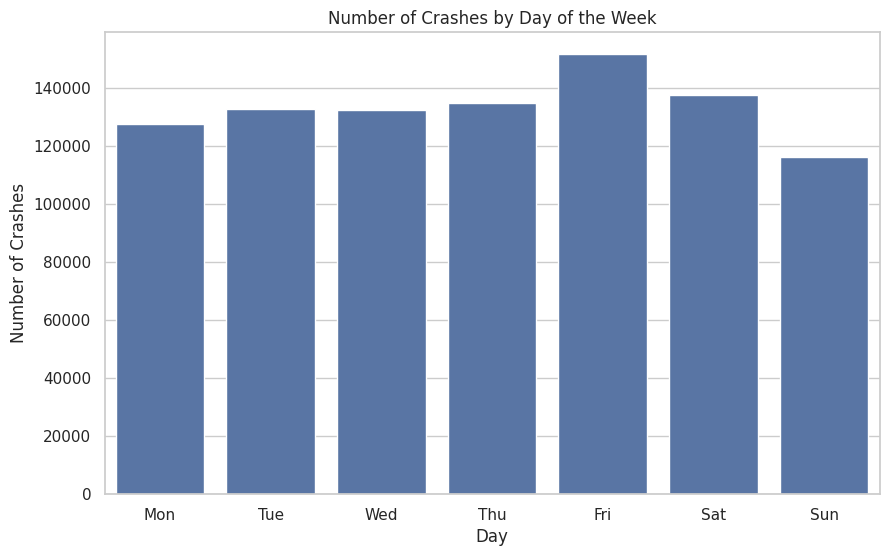

In [ ]:
day_labels = ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun']
crash_by_day = crashes_df['CRASH_DAY_OF_WEEK'].value_counts().sort_index()
crash_by_day.index = day_labels

sns.barplot(x=crash_by_day.index, y=crash_by_day.values)
plt.title('Number of Crashes by Day of the Week')
plt.xlabel('Day')
plt.ylabel('Number of Crashes')
plt.show()

<ipython-input-81-025687f3d7a0>:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=season_counts.index, y=season_counts.values,


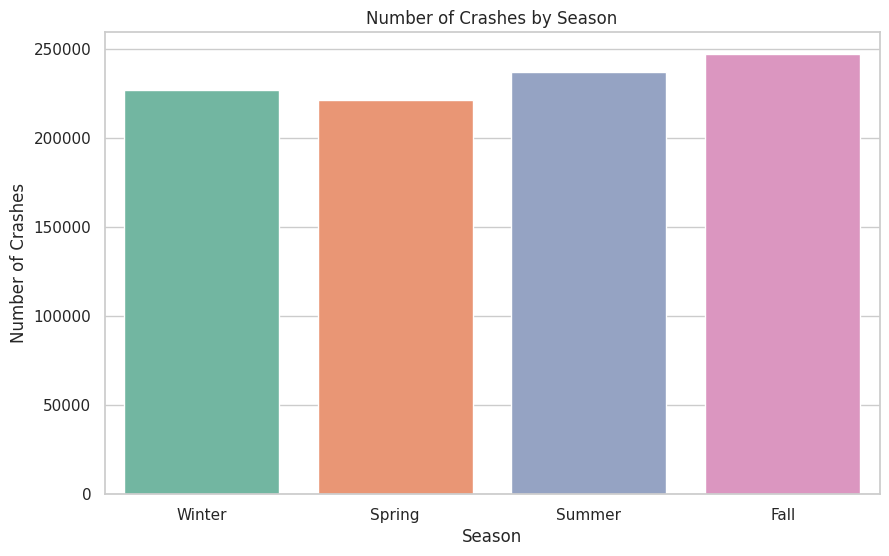

In [ ]:
season_counts = crashes_df['SEASON'].value_counts()

sns.barplot(x=season_counts.index, y=season_counts.values,
            order=['Winter', 'Spring', 'Summer', 'Fall'], palette='Set2')
plt.title('Number of Crashes by Season')
plt.xlabel('Season')
plt.ylabel('Number of Crashes')
plt.show()


<ipython-input-82-e246f6e58e68>:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(y=type_counts.index, x=type_counts.values, palette='pastel')


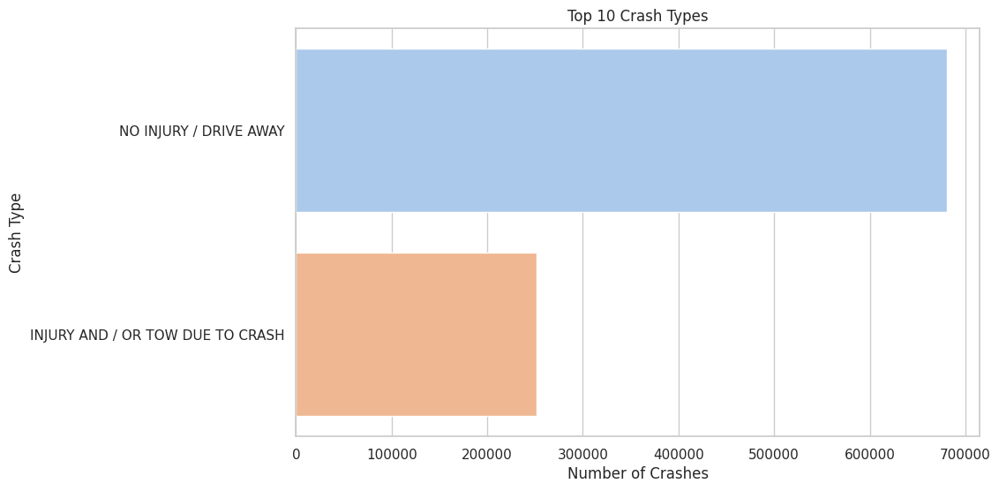

In [ ]:
type_counts = crashes_df['CRASH_TYPE'].value_counts().head(10)

sns.barplot(y=type_counts.index, x=type_counts.values, palette='pastel')
plt.title('Top 10 Crash Types')
plt.xlabel('Number of Crashes')
plt.ylabel('Crash Type')
plt.show()


<ipython-input-83-908a21c702ea>:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='CRASH_TYPE', data=crashes_df, palette='pastel')


<Axes: xlabel='CRASH_TYPE', ylabel='count'>

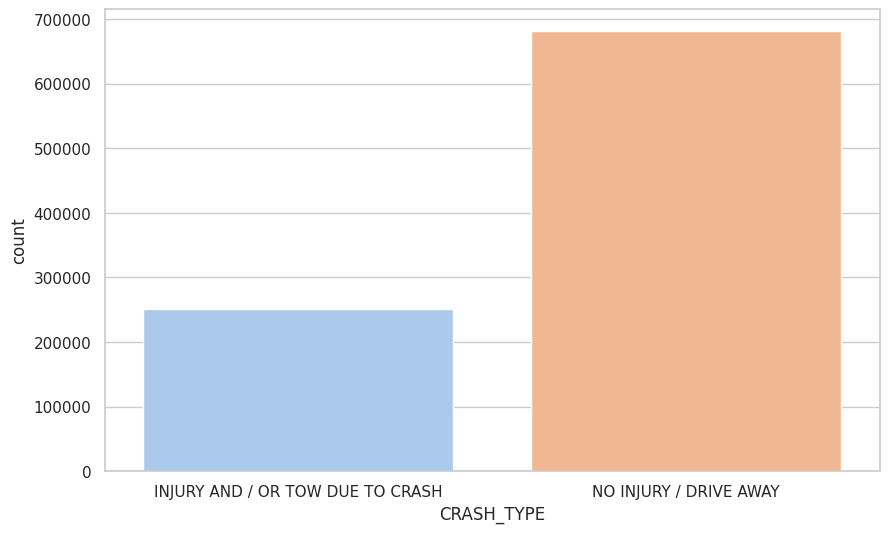

In [ ]:
#plot crash by crash type
plt.figure(figsize=(10,6))
sns.countplot(x='CRASH_TYPE', data=crashes_df, palette='pastel')


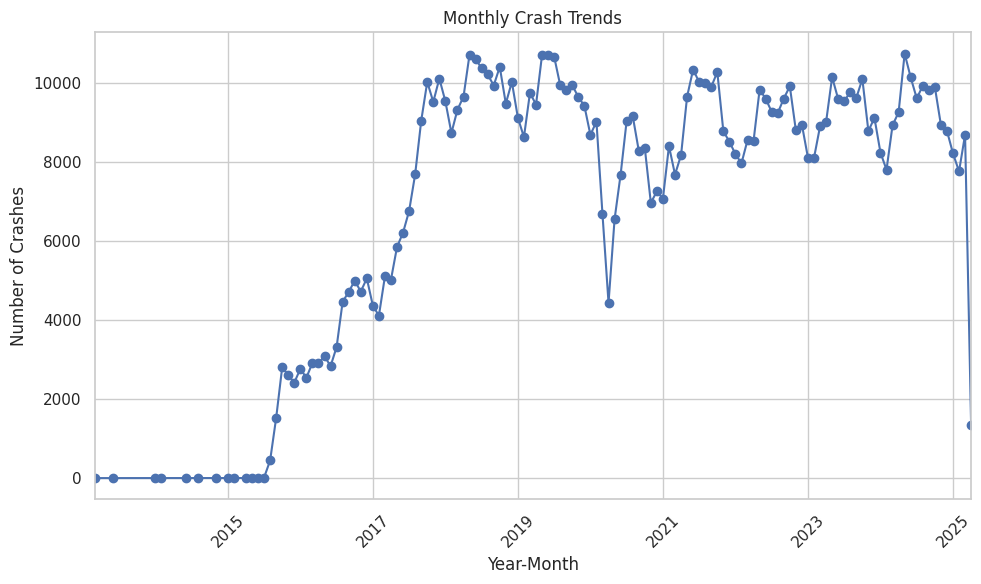

In [ ]:
# Monthly crashes
crashes_df['CRASH_YEAR_MONTH'] = crashes_df['CRASH_DATE'].dt.to_period('M')
monthly_trend = crashes_df['CRASH_YEAR_MONTH'].value_counts().sort_index()

monthly_trend.plot(kind='line', marker='o')
plt.title('Monthly Crash Trends')
plt.xlabel('Year-Month')
plt.ylabel('Number of Crashes')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


<ipython-input-85-596d2c37d76e>:18: UserWarning: Glyph 128664 (\N{ONCOMING AUTOMOBILE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128664 (\N{ONCOMING AUTOMOBILE}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


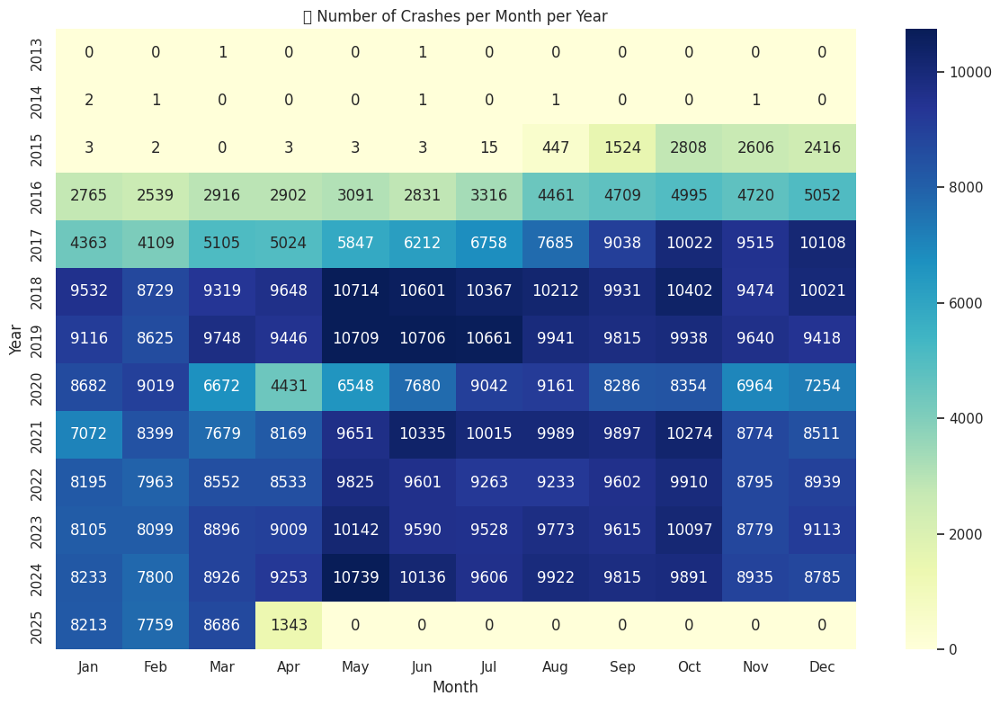

In [ ]:
# Extract year and month
crashes_df['CRASH_YEAR'] = crashes_df['CRASH_DATE'].dt.year
crashes_df['CRASH_MONTH'] = crashes_df['CRASH_DATE'].dt.month

# Group and pivot to create heatmap matrix
year_month_pivot = crashes_df.groupby(['CRASH_YEAR', 'CRASH_MONTH']).size().unstack(fill_value=0)

# Rename columns as month names for better readability
import calendar
year_month_pivot.columns = [calendar.month_abbr[m] for m in year_month_pivot.columns]

# Plot the heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(year_month_pivot, annot=True, fmt='d', cmap='YlGnBu')
plt.title('🚘 Number of Crashes per Month per Year')
plt.xlabel('Month')
plt.ylabel('Year')
plt.tight_layout()
plt.show()


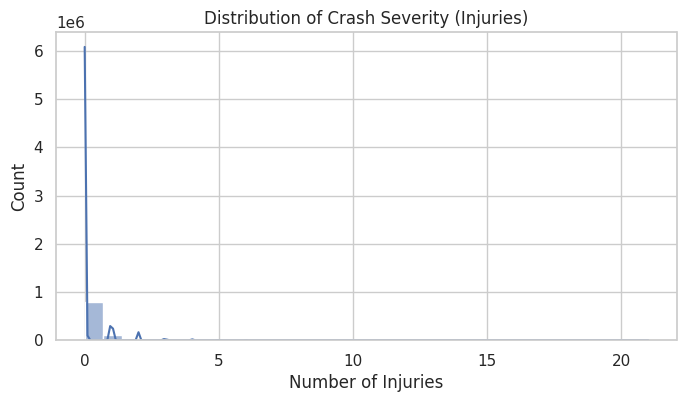

In [ ]:
# 1. Crash Severity Proxy: INJURIES_TOTAL
plt.figure(figsize=(8,4))
sns.histplot(crashes_df['INJURIES_TOTAL'], bins=30, kde=True)
plt.title('Distribution of Crash Severity (Injuries)')
plt.xlabel('Number of Injuries')
plt.show()

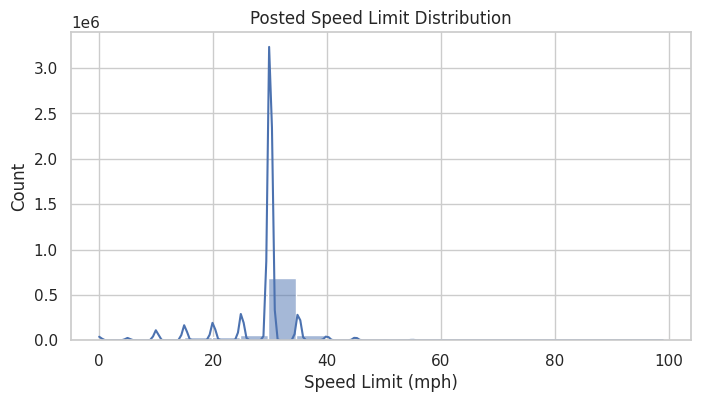

In [ ]:
# 2. Speed Limit
plt.figure(figsize=(8,4))
sns.histplot(crashes_df['POSTED_SPEED_LIMIT'], bins=20, kde=True)
plt.title('Posted Speed Limit Distribution')
plt.xlabel('Speed Limit (mph)')
plt.show()

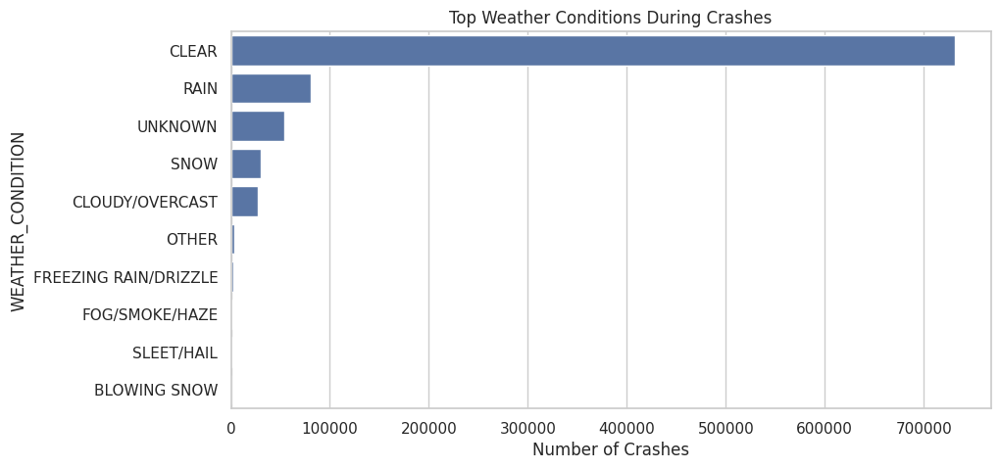

In [ ]:
# 3. Weather Conditions
plt.figure(figsize=(10,5))
sns.countplot(data=crashes_df, y='WEATHER_CONDITION', order=crashes_df['WEATHER_CONDITION'].value_counts().head(10).index)
plt.title('Top Weather Conditions During Crashes')
plt.xlabel('Number of Crashes')
plt.show()


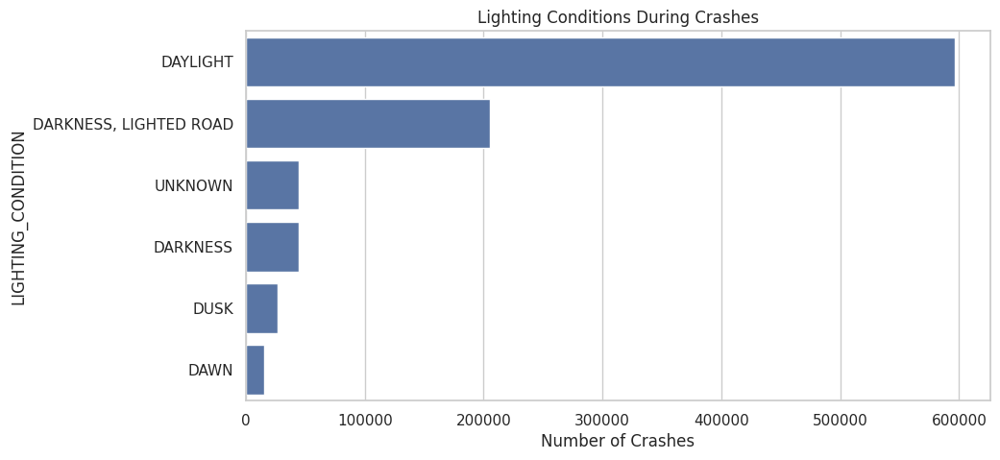

In [ ]:
# 4. Lighting Conditions
plt.figure(figsize=(10,5))
sns.countplot(data=crashes_df, y='LIGHTING_CONDITION', order=crashes_df['LIGHTING_CONDITION'].value_counts().head(10).index)
plt.title('Lighting Conditions During Crashes')
plt.xlabel('Number of Crashes')
plt.show()

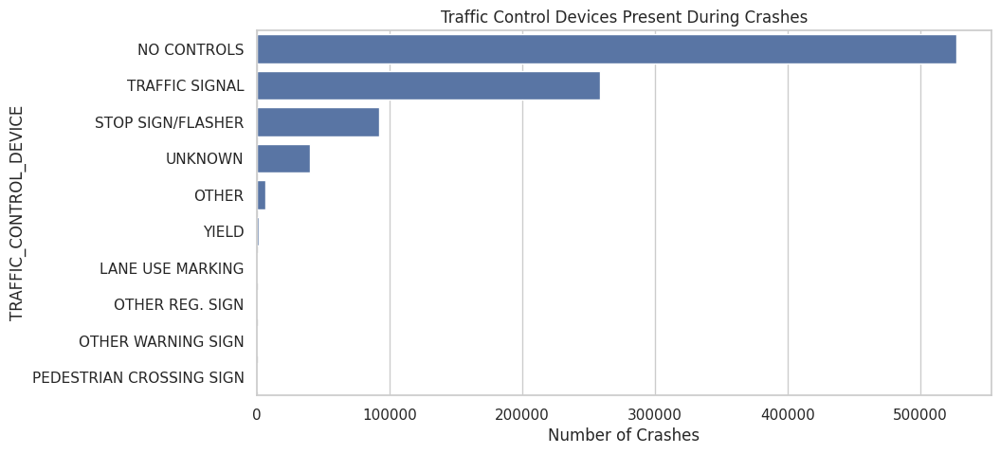

In [ ]:
# 5. Traffic Control Devices
plt.figure(figsize=(10,5))
sns.countplot(data=crashes_df, y='TRAFFIC_CONTROL_DEVICE', order=crashes_df['TRAFFIC_CONTROL_DEVICE'].value_counts().head(10).index)
plt.title('Traffic Control Devices Present During Crashes')
plt.xlabel('Number of Crashes')
plt.show()

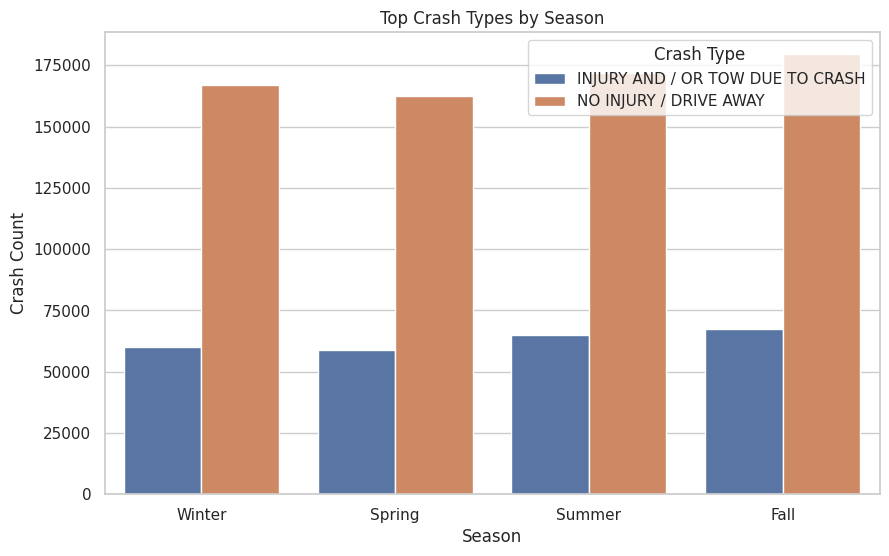

In [ ]:
# Top 5 crash types by season
top_types = crashes_df['CRASH_TYPE'].value_counts().head(5).index
filtered = crashes_df[crashes_df['CRASH_TYPE'].isin(top_types)]

sns.countplot(data=filtered, x='SEASON', hue='CRASH_TYPE', order=['Winter', 'Spring', 'Summer', 'Fall'])
plt.title('Top Crash Types by Season')
plt.ylabel('Crash Count')
plt.xlabel('Season')
plt.legend(title='Crash Type')
plt.show()


<Axes: xlabel='STREET_NAME'>

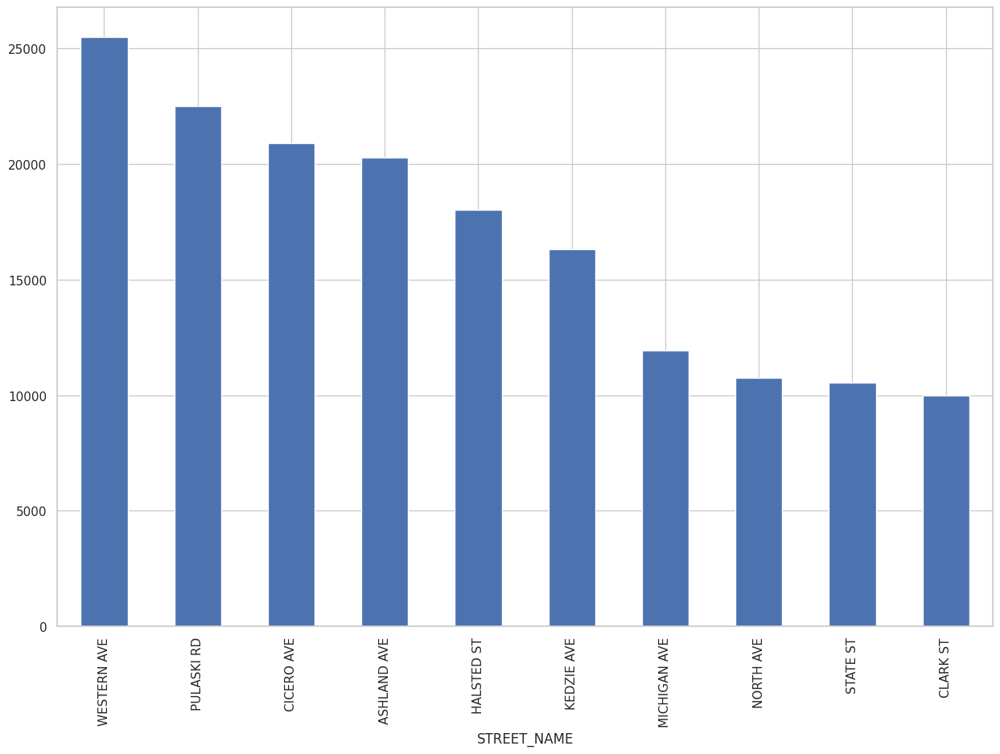

In [ ]:
#plot top 10 streets with most crashes
street_crashes = crashes_df['STREET_NAME'].value_counts().head(10)
plt.figure(figsize=(15,10))
street_crashes.plot(kind='bar')

<ipython-input-93-242ba069ee8a>:31: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(
<ipython-input-93-242ba069ee8a>:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([''] * len(top_5_crashes))  # Hide x labels
<ipython-input-93-242ba069ee8a>:31: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(
<ipython-input-93-242ba069ee8a>:42: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([''] * len(top_5_crashes))  # Hide x labels
<ipython-input-93-242ba069ee8a>:31: FutureWarning: 

Passing `palette`

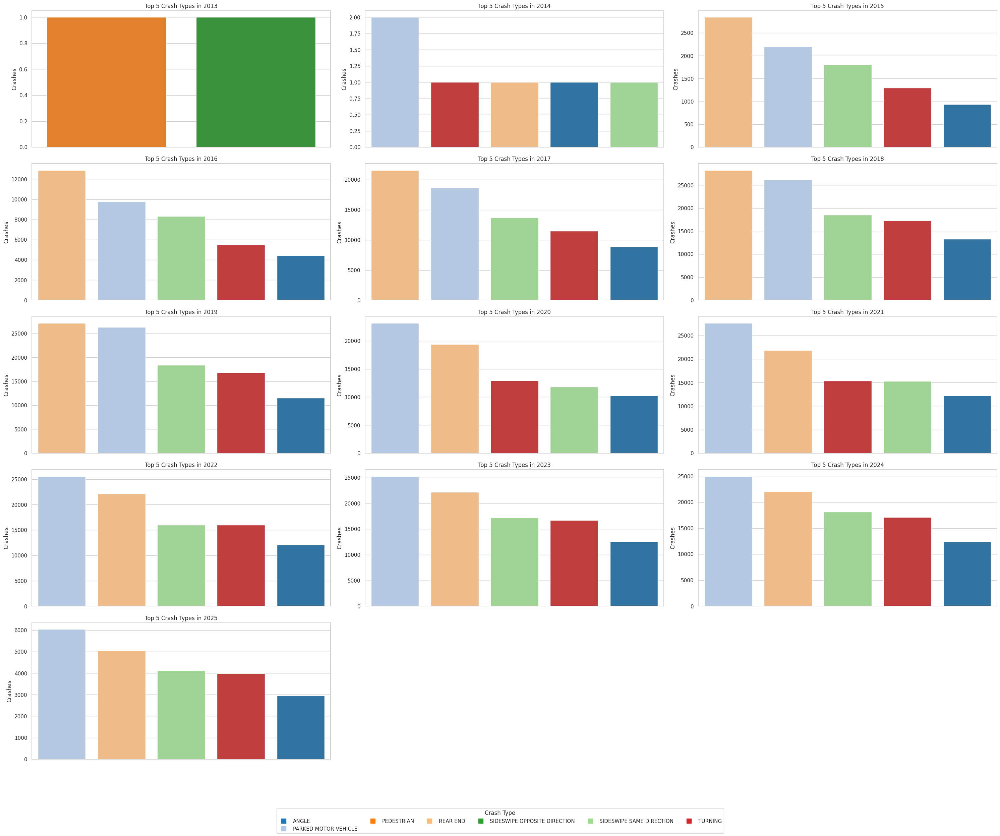

In [ ]:

# Step 1: Collect all unique top 5 crash types across years
top_crash_types_set = set()

for year in crashes_df['CRASH_YEAR'].unique():
    year_data = crashes_df[crashes_df['CRASH_YEAR'] == year]
    top_crashes = year_data['FIRST_CRASH_TYPE'].value_counts().head(5).index
    top_crash_types_set.update(top_crashes)

top_crash_types_all_years = sorted(top_crash_types_set)

# Step 2: Create a color palette
palette = sns.color_palette("tab20", n_colors=len(top_crash_types_all_years))
color_map = dict(zip(top_crash_types_all_years, palette))

# Step 3: Plotting setup
num_years = len(crashes_df['CRASH_YEAR'].unique())
num_rows = math.ceil(num_years / 3)

fig, axes = plt.subplots(num_rows, 3, figsize=(30, 5 * num_rows))
axes = axes.flatten()  # Flatten in case there's only 1 row

year_index = 0

for year in sorted(crashes_df['CRASH_YEAR'].unique()):
    ax = axes[year_index]

    year_data = crashes_df[crashes_df['CRASH_YEAR'] == year]
    top_5_crashes = year_data['FIRST_CRASH_TYPE'].value_counts().head(5).index
    filtered_data = year_data[year_data['FIRST_CRASH_TYPE'].isin(top_5_crashes)]

    sns.countplot(
        x='FIRST_CRASH_TYPE',
        data=filtered_data,
        order=top_5_crashes,
        ax=ax,
        palette={k: color_map[k] for k in top_5_crashes}
    )

    ax.set_title(f'Top 5 Crash Types in {year}')
    ax.set_xlabel('')
    ax.set_ylabel('Crashes')
    ax.set_xticklabels([''] * len(top_5_crashes))  # Hide x labels
    year_index += 1

# Hide any unused subplots
for i in range(year_index, len(axes)):
    fig.delaxes(axes[i])

# Step 4: Add a legend (color key)
handles = [
    plt.Line2D([0], [0], marker='s', color=color_map[crash_type], linestyle='',
               markersize=10, label=crash_type)
    for crash_type in top_crash_types_all_years
]

fig.legend(handles=handles, loc='lower center', ncol=6, title="Crash Type")

plt.tight_layout(rect=[0, 0.08, 1, 1])  # Leave space at bottom for legend
plt.show()


### Crash Locations Map

Using latitude and longitude, we can visualize the geographical distribution of crashes.


In [ ]:
# Filter out invalid coordinates
geo_df = crashes_df.dropna(subset=["LATITUDE", "LONGITUDE"])

# Sample to avoid overload
sample_geo = geo_df.sample(n=5000, random_state=42)

fig = px.scatter_mapbox(sample_geo,
                        lat="LATITUDE",
                        lon="LONGITUDE",
                        color="INJURIES_TOTAL",
                        # size="INJURIES_TOTAL",
                        color_continuous_scale="Reds",
                        mapbox_style="carto-positron",
                        zoom=10,
                        title="Crash Locations with Injury Severity")
fig.show()


In [ ]:
!pip install folium


In [ ]:
import folium
from folium.plugins import HeatMap

# Filter for valid coordinates (Chicago area)
crash_locations = crashes_df[['LATITUDE', 'LONGITUDE']].dropna()
crash_locations = crash_locations[(crash_locations['LATITUDE'] != 0) & (crash_locations['LONGITUDE'] != 0)]

# Create base map centered around Chicago
m = folium.Map(location=[41.8781, -87.6298], zoom_start=11, tiles='CartoDB positron')

# Add HeatMap
heat_data = [[row['LATITUDE'], row['LONGITUDE']] for index, row in crash_locations.iterrows()]
HeatMap(heat_data, radius=7, blur=10).add_to(m)

# Display map
m


# 2. Crashes with Injuries Only

In [ ]:
m2 = folium.Map(location=[41.8781, -87.6298], zoom_start=11, tiles='CartoDB positron')

injury_crashes = crashes_df[
    (crashes_df['INJURIES_TOTAL'] > 0) &
    (crashes_df['LATITUDE'].notna()) &
    (crashes_df['LONGITUDE'].notna()) &
    (crashes_df['LATITUDE'] != 0) &
    (crashes_df['LONGITUDE'] != 0)
]

HeatMap(injury_crashes[['LATITUDE', 'LONGITUDE']].values.tolist(), radius=7, blur=10).add_to(m2)
m2


# 3. Crashes During Snowy or Rainy Weather

In [ ]:
m3 = folium.Map(location=[41.8781, -87.6298], zoom_start=11, tiles='CartoDB positron')

weather_crashes = crashes_df[
    (crashes_df['WEATHER_CONDITION'].str.contains('RAIN|SNOW', case=False, na=False)) &
    (crashes_df['LATITUDE'].notna()) &
    (crashes_df['LONGITUDE'].notna()) &
    (crashes_df['LATITUDE'] != 0) &
    (crashes_df['LONGITUDE'] != 0)
]

HeatMap(weather_crashes[['LATITUDE', 'LONGITUDE']].values.tolist(), radius=7, blur=10).add_to(m3)
m3


In [ ]:
import plotly.express as px

# Filter valid locations
plotly_crashes = crashes_df[
    (crashes_df['LATITUDE'].notna()) &
    (crashes_df['LONGITUDE'].notna()) &
    (crashes_df['LATITUDE'] != 0) &
    (crashes_df['LONGITUDE'] != 0)
]

# Basic crash map
fig = px.scatter_mapbox(
    plotly_crashes.sample(5000),  # limit to 5k for performance
    lat='LATITUDE',
    lon='LONGITUDE',
    color='INJURIES_TOTAL',
    hover_name='CRASH_DATE',
    hover_data={'LATITUDE': False, 'LONGITUDE': False, 'INJURIES_TOTAL': True, 'WEATHER_CONDITION': True},
    zoom=10,
    height=600,
    color_continuous_scale='Blues'
)

fig.update_layout(mapbox_style='carto-positron')
fig.update_layout(title='Crashes in Chicago (Injury Severity Color-Coded)', margin={"r":0,"t":40,"l":0,"b":0})
fig.show()


# Task 2 Overview: Clustering High-Risk Zones

In [ ]:
#updated with gem
# Aggregate Per Beat
# Ensure CRASH_DATE is datetime
crashes_df['CRASH_DATE'] = pd.to_datetime(crashes_df['CRASH_DATE'])

# Extract year and month
crashes_df['YEAR'] = crashes_df['CRASH_DATE'].dt.year
crashes_df['MONTH'] = crashes_df['CRASH_DATE'].dt.month

# Re-create incident_profiles
# The original code mixes tuple and lambda function syntax within the agg function.
# This is corrected below by consistently using tuples for all aggregations:

incident_profiles = crashes_df.groupby(['BEAT_OF_OCCURRENCE', 'YEAR', 'MONTH']).agg(
    total_crashes=('CRASH_RECORD_ID', 'count'),
    avg_injuries=('INJURIES_TOTAL', 'mean'),
    avg_speed_limit=('POSTED_SPEED_LIMIT', 'mean'),
    pct_weather_impact=('WEATHER_CONDITION', lambda x: x.str.contains('RAIN|SNOW', case=False, na=False).mean()),
    pct_night_crashes=('LIGHTING_CONDITION', lambda x: x.str.contains('DARK', case=False, na=False).mean())
).reset_index()

# Aggregate indicators over all months/years per BEAT
beat_profiles = incident_profiles.groupby('BEAT_OF_OCCURRENCE').agg({
    'total_crashes': 'mean',
    'avg_injuries': 'mean',
    'avg_speed_limit': 'mean',
    'pct_weather_impact': 'mean',
    'pct_night_crashes': 'mean'
}).reset_index()

## Normalize Features

In [ ]:
from sklearn.preprocessing import StandardScaler

features = beat_profiles.drop(columns=['BEAT_OF_OCCURRENCE'])
scaler = StandardScaler()
X_scaled = scaler.fit_transform(features)


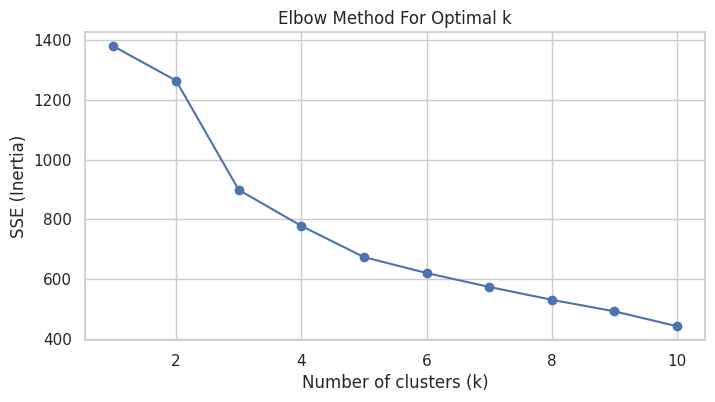

In [ ]:
from sklearn.cluster import KMeans
sse = []
for k in range(1, 11):
    km = KMeans(n_clusters=k, random_state=42)
    km.fit(X_scaled)
    sse.append(km.inertia_)

# Plot the elbow
plt.figure(figsize=(8, 4))
plt.plot(range(1, 11), sse, marker='o')
plt.xlabel('Number of clusters (k)')
plt.ylabel('SSE (Inertia)')
plt.title('Elbow Method For Optimal k')
plt.grid(True)
plt.show()


In [ ]:
kmeans = KMeans(n_clusters=4, random_state=42)
beat_profiles['cluster'] = kmeans.fit_predict(X_scaled)


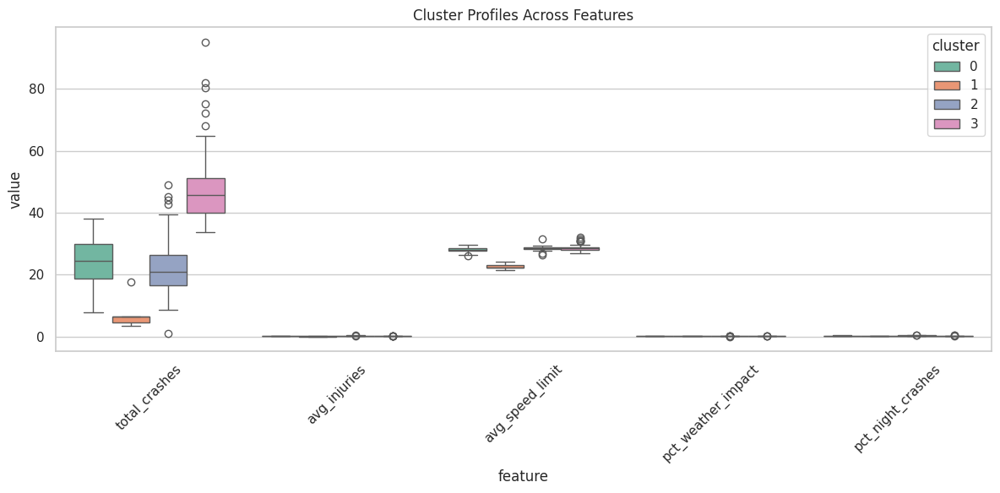

In [ ]:
# Reshape for plotting
# melted = beat_profiles.melt(id_vars='cluster', var_name='feature', value_name='value')
# Drop beat column before plotting
melted = beat_profiles.drop(columns='BEAT_OF_OCCURRENCE').melt(id_vars='cluster', var_name='feature', value_name='value')


# Plot
plt.figure(figsize=(12, 6))
sns.boxplot(data=melted, x='feature', y='value', hue='cluster', palette='Set2')
plt.title('Cluster Profiles Across Features')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()



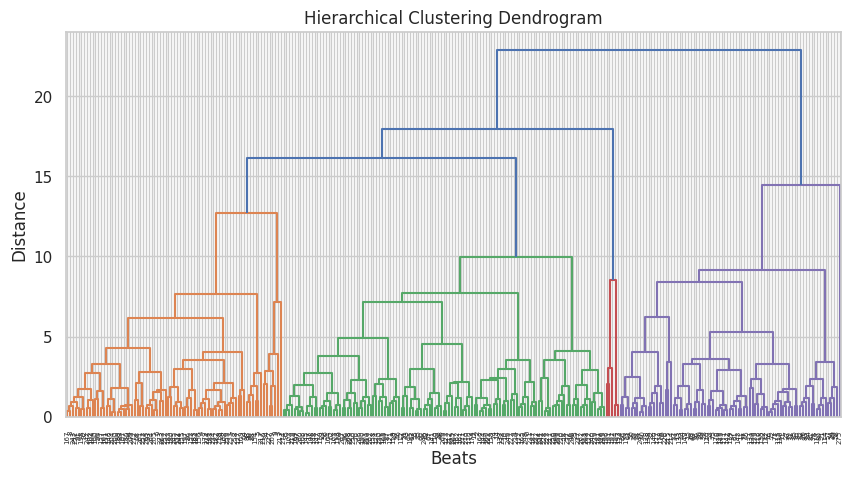

In [ ]:
from scipy.cluster.hierarchy import linkage, dendrogram

linked = linkage(X_scaled, method='ward')

plt.figure(figsize=(10, 5))
dendrogram(linked, orientation='top', distance_sort='descending', show_leaf_counts=False)
plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Beats")
plt.ylabel("Distance")
plt.show()


In [ ]:
from sklearn.cluster import DBSCAN

db = DBSCAN(eps=1.5, min_samples=3)
labels = db.fit_predict(X_scaled)
beat_profiles['dbscan_cluster'] = labels


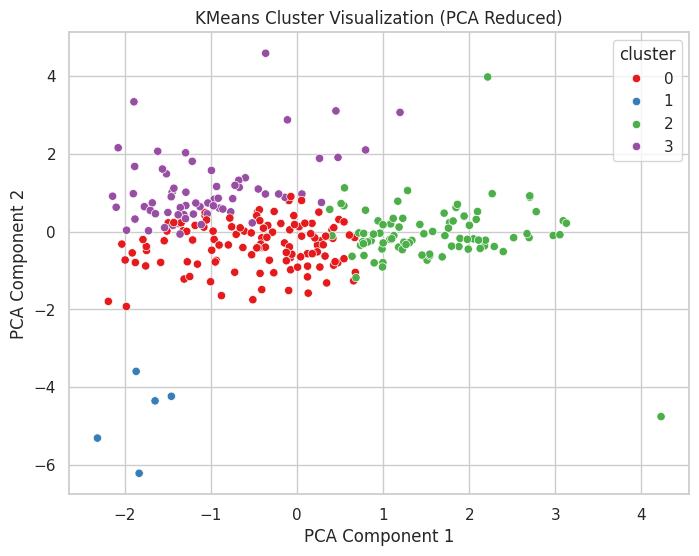

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

plt.figure(figsize=(8, 6))
sns.scatterplot(x=X_pca[:, 0], y=X_pca[:, 1], hue=beat_profiles['cluster'], palette='Set1')
plt.title('KMeans Cluster Visualization (PCA Reduced)')
plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')
plt.grid(True)
plt.show()


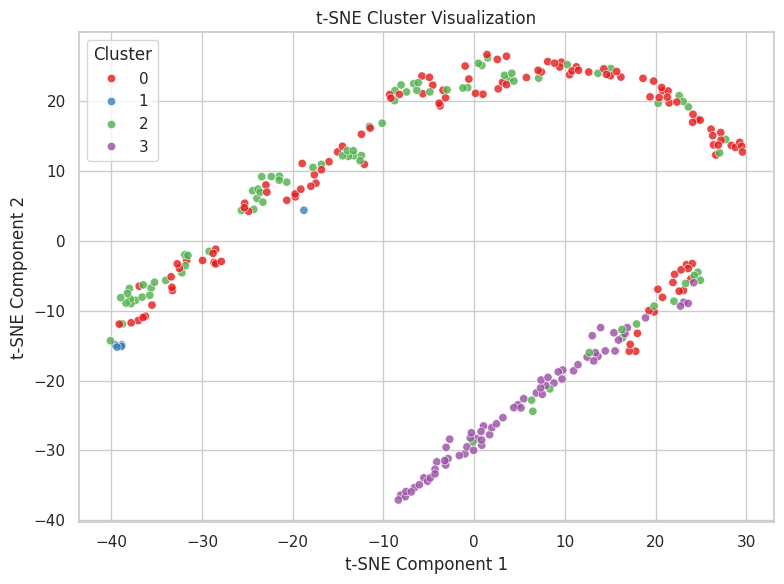

In [ ]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import seaborn as sns

# Step 1: Standardized features (assume already used for clustering)
features = ['total_crashes', 'avg_injuries', 'avg_speed_limit',
            'pct_weather_impact', 'pct_night_crashes']

# Step 2: Run t-SNE
tsne = TSNE(n_components=2, perplexity=13, random_state=42)
scaled_data = beat_profiles[features] # Assign the scaled data to scaled_data
tsne_results = tsne.fit_transform(scaled_data)

# Step 3: Combine with cluster labels
tsne_df = pd.DataFrame(tsne_results, columns=['TSNE1', 'TSNE2'])
# Replace 'cluster_labels' with 'beat_profiles['cluster']' to access the cluster assignments:
tsne_df['cluster'] = beat_profiles['cluster']

# Step 4: Visualize
plt.figure(figsize=(8, 6))
sns.scatterplot(data=tsne_df, x='TSNE1', y='TSNE2', hue='cluster', palette='Set1', alpha=0.8)
plt.title("t-SNE Cluster Visualization")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.legend(title='Cluster')
plt.tight_layout()
plt.show()

In [5]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

# Load datasets
crashes = pd.read_csv(
    '/content/drive/MyDrive/Traffic_Crashes_-_Crashes_20250407.csv',
    parse_dates=['CRASH_DATE'],
    date_format='%m/%d/%Y %I:%M:%S %p',  # Handles date and time with AM/PM
    low_memory=False
)
people = pd.read_csv('/content/drive/MyDrive/Traffic_Crashes_-_People_20250407.csv', low_memory=False)
vehicles = pd.read_csv('/content/drive/MyDrive/Traffic_Crashes_-_Vehicles_20250407.csv', low_memory=False)

# Convert DAMAGE to numerical values
def damage_to_numeric(damage_str):
    if pd.isna(damage_str):
        return np.nan
    cleaned = str(damage_str).replace('$', '').replace(',', '')
    if '-' in cleaned:
        low, high = map(float, cleaned.split(' - '))
        return (low + high) / 2
    if 'OVER' in cleaned:
        return 1_500_000  # Domain-based approximation
    return np.nan

crashes['DAMAGE_NUM'] = crashes['DAMAGE'].apply(damage_to_numeric)

# Process people and vehicle data
people_agg = people.groupby('CRASH_RECORD_ID').agg(
    num_people=('PERSON_ID', 'count'),
    avg_age=('AGE', 'mean'),
    num_injuries=('INJURY_CLASSIFICATION', lambda x: (x == 'INJURED').sum()),
    num_fatalities=('INJURY_CLASSIFICATION', lambda x: (x == 'FATAL').sum())
).reset_index()

vehicles_agg = vehicles.groupby('CRASH_RECORD_ID').agg(
    num_vehicles=('VEHICLE_ID', 'count'),
    num_towed=('TOWED_I', lambda x: (x == 'YES').sum())
).reset_index()

# Process crashes data (for DAMAGE)
crashes_agg = crashes.groupby('CRASH_RECORD_ID').agg(
    avg_damage_per_crash=('DAMAGE_NUM', 'mean')  # Aggregate DAMAGE_NUM
).reset_index()

# Merge all datasets
merged = crashes.merge(crashes_agg, on='CRASH_RECORD_ID', how='left') \
               .merge(people_agg, on='CRASH_RECORD_ID', how='left') \
               .merge(vehicles_agg, on='CRASH_RECORD_ID', how='left')

# Create temporal features
merged['YEAR_MONTH'] = merged['CRASH_DATE'].dt.to_period('M')
merged['BEAT_YEAR_MONTH'] = merged['BEAT_OF_OCCURRENCE'].astype(str) + '_' + merged['YEAR_MONTH'].astype(str)

# Create final profiles with target variable
profile_features = merged.groupby('BEAT_YEAR_MONTH').agg(
    avg_age=('avg_age', 'mean'),
    avg_speed_limit=('POSTED_SPEED_LIMIT', 'mean'),
    total_injuries=('num_injuries', 'sum'),
    severe_injuries=('num_fatalities', 'sum'),
    avg_vehicles=('num_vehicles', 'mean'),
    avg_people=('num_people', 'mean'),
    avg_damage=('avg_damage_per_crash', 'mean')  # Target variable
).reset_index()

# Handle missing values
profile_features = profile_features.fillna(profile_features.median(numeric_only=True))

# Print summary
print(profile_features.head())

  BEAT_YEAR_MONTH    avg_age  avg_speed_limit  total_injuries  \
0  1011.0_2015-08  46.000000        30.000000             0.0   
1  1011.0_2015-10  36.583333        28.000000             0.0   
2  1011.0_2015-11  28.333333        29.500000             0.0   
3  1011.0_2015-12  41.750000        27.500000             0.0   
4  1011.0_2016-01  39.777778        28.571429             0.0   

   severe_injuries  avg_vehicles  avg_people    avg_damage  
0              0.0      2.000000    2.000000  1.500000e+06  
1              0.0      2.000000    2.200000  9.004002e+05  
2              0.0      2.000000    2.000000  7.505002e+05  
3              0.0      2.000000    2.500000  1.500000e+06  
4              0.0      2.285714    1.857143  1.285857e+06  


Decision Tree MSE: 90354388123.76
KNN MSE: 52910386988.60
Random Forest MSE: 49425320260.99


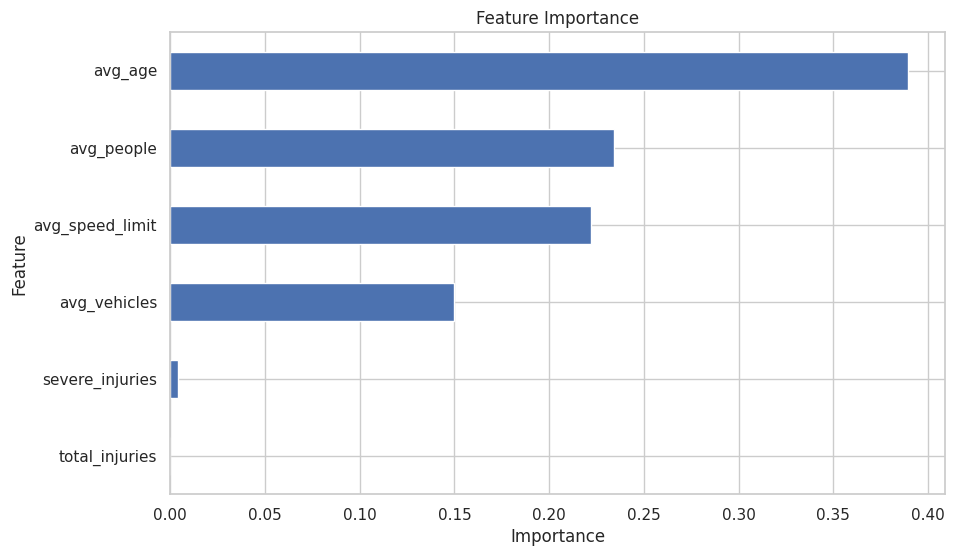

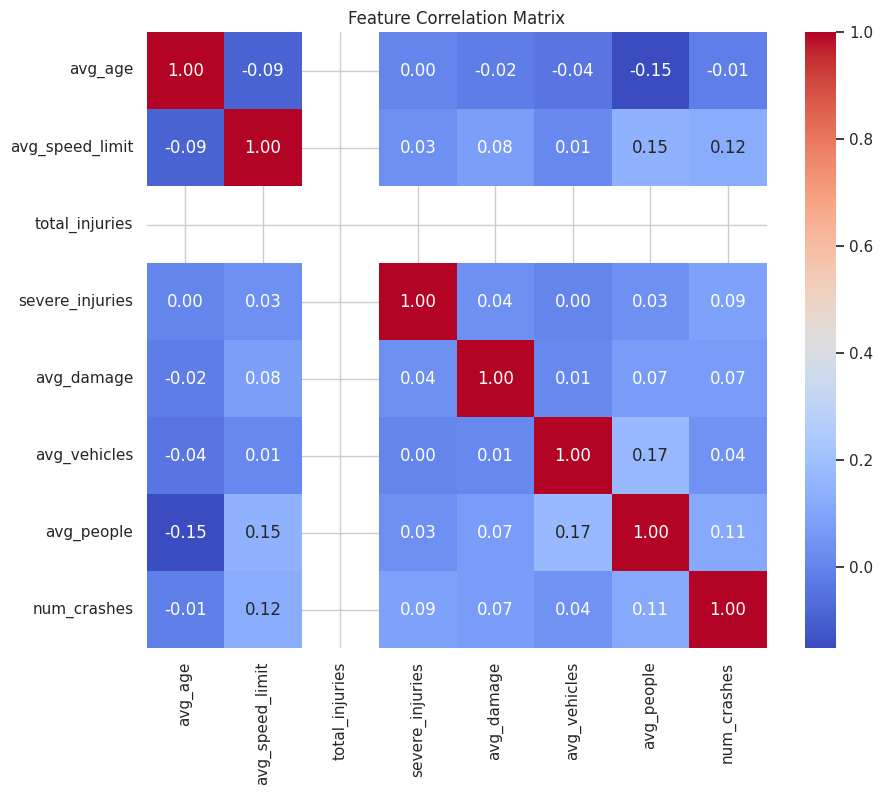

In [ ]:
# === TASK 3: PREDICTIVE ANALYSIS ===
# Prepare features and target
X = profile_features[[
    'avg_age',
    'avg_speed_limit',
    'total_injuries',
    'severe_injuries',
    'avg_vehicles',
    'avg_people'
]]
y = profile_features['avg_damage']

# Split data
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# Feature scaling for KNN
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Model training and evaluation
models = {
    'Decision Tree': DecisionTreeRegressor(random_state=42),
    'KNN': KNeighborsRegressor(),
    'Random Forest': RandomForestRegressor(random_state=42)
}

results = {}
for name, model in models.items():
    if name == 'KNN':
        model.fit(X_train_scaled, y_train)
        pred = model.predict(X_test_scaled)
    else:
        model.fit(X_train, y_train)
        pred = model.predict(X_test)

    mse = mean_squared_error(y_test, pred)
    results[name] = mse
    print(f"{name} MSE: {mse:.2f}")

# Feature importance analysis (Random Forest)
rf = RandomForestRegressor(random_state=42)
rf.fit(X_train, y_train)
importances = pd.Series(rf.feature_importances_, index=X.columns)
importances.sort_values().plot(
    kind='barh',
    title='Feature Importance',
    xlabel='Importance',
    ylabel='Feature'
)
plt.show()

# === ADDITIONAL ANALYSIS ===
# Correlation matrix
numeric_features = profile_features.select_dtypes(include=[np.number])
corr_matrix = numeric_features.corr()
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Feature Correlation Matrix')
plt.show()

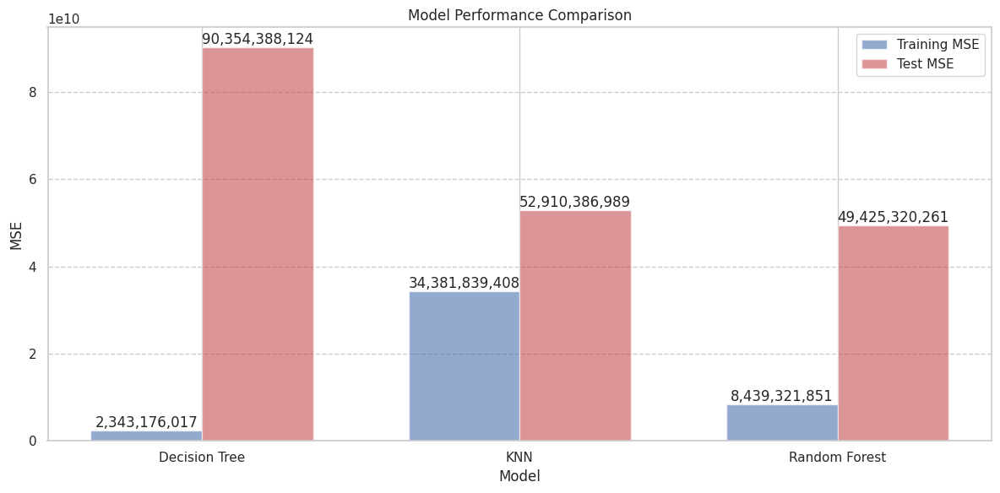

In [ ]:
# Load processed data
profile_features = pd.read_csv('processed_profiles.csv')

# Prepare features and target
X = profile_features[[
    'avg_age',
    'avg_speed_limit',
    'total_injuries',
    'severe_injuries',
    'avg_vehicles',
    'avg_people'
]]
y = profile_features['avg_damage']

# Split data
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# Scale features for KNN
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Initialize models
models = {
    'Decision Tree': DecisionTreeRegressor(random_state=42),
    'KNN': KNeighborsRegressor(),
    'Random Forest': RandomForestRegressor(random_state=42)
}

# Prepare results storage
results = {
    'Model': [],
    'Training MSE': [],
    'Test MSE': []
}

# Train and evaluate models
for name, model in models.items():
    if name == 'KNN':
        model.fit(X_train_scaled, y_train)
        train_pred = model.predict(X_train_scaled)
        test_pred = model.predict(X_test_scaled)
    else:
        model.fit(X_train, y_train)
        train_pred = model.predict(X_train)
        test_pred = model.predict(X_test)

    train_mse = mean_squared_error(y_train, train_pred)
    test_mse = mean_squared_error(y_test, test_pred)

    results['Model'].append(name)
    results['Training MSE'].append(train_mse)
    results['Test MSE'].append(test_mse)

# Create results DataFrame
results_df = pd.DataFrame(results)

# Generate visualization
plt.figure(figsize=(12, 6))
bar_width = 0.35
index = np.arange(len(results_df))

# Plot training MSE
plt.bar(
    index,
    results_df['Training MSE'],
    bar_width,
    label='Training MSE',
    color='b',
    alpha=0.6
)

# Plot test MSE
plt.bar(
    index + bar_width,
    results_df['Test MSE'],
    bar_width,
    label='Test MSE',
    color='r',
    alpha=0.6
)

plt.xlabel('Model')
plt.ylabel('MSE')
plt.title('Model Performance Comparison')
plt.xticks(index + bar_width/2, results_df['Model'])
plt.legend()
plt.grid(axis='y', linestyle='--')

# Add value labels
for i, row in results_df.iterrows():
    plt.text(i, row['Training MSE']+0.1e6, f"{row['Training MSE']:,.0f}",
             ha='center', va='bottom')
    plt.text(i + bar_width, row['Test MSE']+0.1e6, f"{row['Test MSE']:,.0f}",
             ha='center', va='bottom')

plt.tight_layout()
plt.show()

In [ ]:
# Convert BEAT_YEAR_MONTH to datetime for time-based operations
profile_features['BEAT_YEAR_MONTH'] = pd.to_datetime(
    profile_features['BEAT_YEAR_MONTH'].str.split('_').str[1].astype(str)
    + '-01',  # Convert "2021-08" to "2021-08-01"
    format='%Y-%m-%d'
)

# Sort by date for time series analysis
profile_features = profile_features.sort_values('BEAT_YEAR_MONTH')

In [ ]:
train_size = int(len(profile_features) * 0.8)
train = profile_features.iloc[:train_size]
test = profile_features.iloc[train_size:]

X_train = train[[
    'avg_age',
    'avg_speed_limit',
    'total_injuries',
    'severe_injuries',
    'avg_vehicles',
    'avg_people'
]]
y_train = train['avg_damage']

X_test = test[[
    'avg_age',
    'avg_speed_limit',
    'total_injuries',
    'severe_injuries',
    'avg_vehicles',
    'avg_people'
]]
y_test = test['avg_damage']

In [ ]:
from sklearn.ensemble import RandomForestRegressor

# Train model on full training data
model = RandomForestRegressor(n_estimators=200, max_depth=20, random_state=42)
model.fit(X_train, y_train)

# Predict on test set
test['predicted_damage'] = model.predict(X_test)

<ipython-input-20-bdaea388f97a>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test['predicted_damage'] = model.predict(X_test)


In [29]:
# Generate future dates (next 12 months)
last_date = profile_features['BEAT_YEAR_MONTH'].max()
future_dates = pd.date_range(
    start=last_date + pd.DateOffset(months=1),
    periods=12,
    freq='MS'
)

# Create future feature values (use last known values as baseline)
future_features = pd.DataFrame({
    'BEAT_YEAR_MONTH': future_dates,
    'avg_age': [X_train['avg_age'].mean()] * 12,
    'avg_speed_limit': [X_train['avg_speed_limit'].mean()] * 12,
    'total_injuries': [X_train['total_injuries'].mean()] * 12,
    'severe_injuries': [X_train['severe_injuries'].mean()] * 12,
    'avg_vehicles': [X_train['avg_vehicles'].mean()] * 12,
    'avg_people': [X_train['avg_people'].mean()] * 12
})

# Predict future damage
future_features['predicted_damage'] = model.predict(future_features.drop('BEAT_YEAR_MONTH', axis=1))

TypeError: can only concatenate str (not "DateOffset") to str

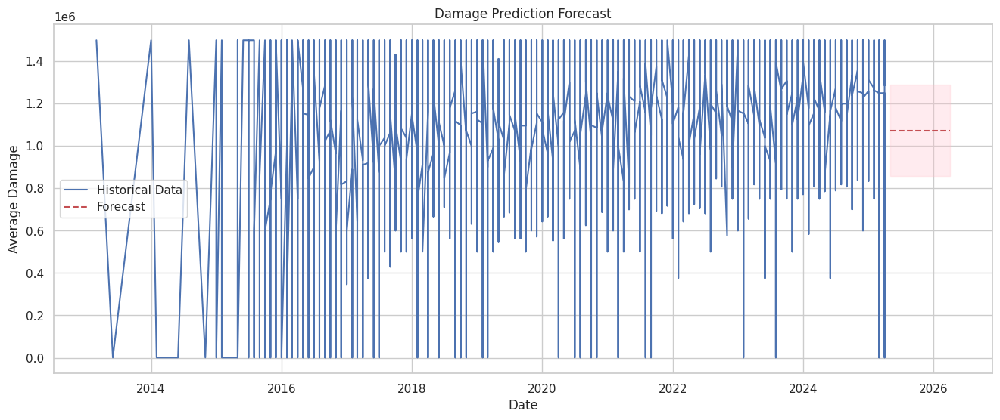

In [ ]:
import matplotlib.pyplot as plt

# Combine historical and future data
historical = profile_features[['BEAT_YEAR_MONTH', 'avg_damage']].rename(columns={'avg_damage': 'Actual'})
future = future_features[['BEAT_YEAR_MONTH', 'predicted_damage']].rename(columns={'predicted_damage': 'Forecast'})

# Create plot
plt.figure(figsize=(16, 6))
plt.plot(historical['BEAT_YEAR_MONTH'], historical['Actual'], label='Historical Data')
plt.plot(future['BEAT_YEAR_MONTH'], future['Forecast'], 'r--', label='Forecast')
plt.fill_between(future['BEAT_YEAR_MONTH'], future['Forecast']*0.8, future['Forecast']*1.2, color='pink', alpha=0.3)
plt.title('Damage Prediction Forecast')
plt.xlabel('Date')
plt.ylabel('Average Damage')
plt.legend()
plt.grid(True)
plt.show()

In [28]:
import pandas as pd
import numpy as np

# Function to clean DAMAGE values
def clean_damage(value):
    if isinstance(value, str):  # Check if the value is a string
        value = value.replace('$', '').replace(',', '')  # Remove dollar signs and commas
        if ' - ' in value:  # Handle ranges like '500 - 1500'
            low, high = map(float, value.split(' - '))
            return (low + high) / 2  # Return the midpoint of the range
        elif 'OVER' in value:  # Handle 'OVER 1500'
            return float(value.split()[-1])  # Extract the numeric part after 'OVER'
    return np.nan  # Return NaN for invalid or missing values

# Load crashes.csv with DAMAGE as string first
crashes = pd.read_csv(
    '/content/drive/MyDrive/Traffic_Crashes_-_Crashes_20250407.csv',
    usecols=[
        'CRASH_RECORD_ID',
        'BEAT_OF_OCCURRENCE',
        'CRASH_DATE',
        'POSTED_SPEED_LIMIT',
        'DAMAGE'
    ],
    dtype={
        'BEAT_OF_OCCURRENCE': 'str',
        'POSTED_SPEED_LIMIT': 'float32',
        'DAMAGE': 'str'  # Read DAMAGE as string initially
    },
    parse_dates=['CRASH_DATE'],
    low_memory=False
)

# Apply the cleaning function to DAMAGE
crashes['DAMAGE'] = crashes['DAMAGE'].apply(clean_damage).astype('float32')

# Drop rows with invalid DAMAGE values
crashes = crashes.dropna(subset=['DAMAGE'])

# Verify the cleaned DAMAGE column
print("Cleaned DAMAGE values. Sample data:")
print(crashes[['DAMAGE']].head())

<ipython-input-28-0fb5533fdace>:16: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  crashes = pd.read_csv(


Cleaned DAMAGE values. Sample data:
   DAMAGE
0  1500.0
1  1500.0
2  1500.0
3  1500.0
6  1500.0


In [ ]:
from statsmodels.tsa.statespace.sarimax import SARIMAX

# Define and fit the model
model = SARIMAX(
    train_data['DAMAGE'],  # Target variable
    order=(1, 1, 1),       # Non-seasonal order (p, d, q)
    seasonal_order=(1, 1, 1, 12)  # Seasonal order (P, D, Q, S)
)
results = model.fit()